# INTRNLP - COVID-19 Tweets Sentiment Analysis

In this notebook, the group aims to find out the sentiment behind the COVID-19 related tweets. The COVID-19 tweets are found by finding keywords in the tweet, which contains both the text and/or the hashtags. The group will use the English tweets available in the whole list of Philippine tweets. The tweets will be preprocessed before using VADER and TextBlob for extraction of sentiment. The top words used per month, together with the positive, neutral and negative words are compiled per month to showcase the words that are trending during the month.

## Authors
Delima Jr., Reynaldo K.
<br>
Jatico II, Nilo Cantil K.
<br>
Tan, Jedwig Siegfrid S.

# Import Libraries

In [1]:
from nltk.stem import WordNetLemmatizer
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from textblob import TextBlob
from wordcloud import WordCloud
import emoji
import matplotlib.pyplot as plt
import nltk
import numpy as np
import os
import re
import pandas as pd
%matplotlib inline

In [2]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /home/jupyter-
[nltk_data]     reynaldo_delimajr/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

# Loading the data

In [3]:
# Return true if file exists. Otherwise, return false.
def check_file_exists(file):
    return os.path.exists(file)

In [4]:
# If all_tweets.csv exists, read the file.
# Otherwise, read all subsets of tweets, and append all of them. Export to .csv afterwards.
if check_file_exists('all_tweets.csv'):
    df = pd.read_csv('all_tweets.csv')
    df.drop(['Unnamed: 0'], inplace=True, axis=1)
else:
    for i in range(0, 24):
        if i == 0:
            df = pd.read_csv(f'Data/tweets_{i}.csv')
        else:
            append_df = pd.read_csv(f'Data/tweets_{i}.csv')
            df = df.append(append_df, ignore_index=True)
    df.to_csv('all_tweets.csv')

/opt/tljh/user/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3441: DtypeWarning: Columns (0) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


# Preprocess the tweets

Let's see if there are any null in our data. If there's a null, drop the row.

In [5]:
df.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5869655 entries, 0 to 5869654
Data columns (total 5 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   tweet_id          5869650 non-null  float64
 1   author_id         5869650 non-null  float64
 2   created_at_utc+8  5869650 non-null  object 
 3   lang              5869650 non-null  object 
 4   text              5869649 non-null  object 
dtypes: float64(2), object(3)
memory usage: 223.9+ MB


There aren't any null values in the corpus. There is no need to drop any rows. Let's see how the data looks like.

In [6]:
df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text
0,1.264847e+18,3.031065e+08,2020-05-25 17:14:30,tl,@alphangela bes wag ganyan ang attitude char i...
1,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow
2,1.264847e+18,1.074248e+18,2020-05-25 17:14:30,tl,@Kookie07Jeon Can't stop laughing tf HAHAHAHAH...
3,1.264847e+18,1.010402e+18,2020-05-25 17:14:30,tl,@azilhanna09 HAHAHAHHAHAHAHHAAA ML NA LANG
4,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...


Let's get all of the English tweets.

In [7]:
df['lang'].unique()

array(['tl', 'en', 'und', 'et', 'es', 'ko', 'nl', 'tr', 'in', 'hi', 'fi',
       'pt', 'de', 'it', 'ca', 'ht', 'pl', 'lt', 'hu', 'sv', 'el', 'cy',
       'da', 'fr', 'cs', 'no', 'eu', 'lv', 'ja', 'sl', 'vi', 'is', 'ro',
       'ar', 'th', nan, 'zh', 'ur', 'ru', 'iw', 'bn', 'ne', 'ta', 'te',
       'am', 'km', 'pa', 'ml', 'mr', 'fa', 'uk', 'hy', 'bg', 'gu', 'sr',
       'dv'], dtype=object)

In [8]:
eng_df = df[df['lang'] == 'en']
eng_df = eng_df.reset_index()
eng_df.drop(['index'], inplace=True, axis=1)

In [9]:
eng_df.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1779586 entries, 0 to 1779585
Data columns (total 5 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   tweet_id          1779586 non-null  float64
 1   author_id         1779586 non-null  float64
 2   created_at_utc+8  1779586 non-null  object 
 3   lang              1779586 non-null  object 
 4   text              1779586 non-null  object 
dtypes: float64(2), object(3)
memory usage: 67.9+ MB


Let's see how `eng_df` looks like.

In [10]:
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...


We acquired all of the English tweets. We'll have to clean the tweets now. We'll create user-defined functions to make cleaning of the tweets easier.

In [11]:
def remove_text_from_regex(text, regex):
    candidates = re.findall(regex, text)
    for candidate in candidates:
        text = re.sub(candidate, '', text)
    return text

In [12]:
def remove_emoji_from_text(text):
    return emoji.get_emoji_regexp().sub(r'', text)

In [13]:
def remove_escape_characters(text):
    return text.replace('\n', ' ').replace('\r', '').replace('\t', ' ')

In [14]:
def make_text_lowercase(text):
    return text.lower()

First, we will remove all `@user` in the tweets. They are unnecessary in finding sentiment.

In [85]:
eng_df['clean_text'] = np.vectorize(remove_text_from_regex)(eng_df['text'], r'@[\w]*')

In [99]:
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow,bridgetowne yow,5,25,2020,[],"[bridgetowne, yow]"
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...,one of my fav #백현 #baekhyun #엑소 #exo #weareone...,5,25,2020,"[#백현, #baekhyun, #엑소, #exo, #weareoneexo, #del...","[one, of, my, fav]"
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!,loveyou!!!,5,25,2020,[],"[loveyou, !, !, !]"
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight,byeee imma listen to the b-tracks #delight,5,25,2020,[#delight],"[byeee, imma, listen, to, the, b-tracks]"
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...,maripol sebastian las piñas city #shop...,5,25,2020,"[#shopee, #frontrow, #gencee, #plemex]","[maripol, sebastian, las, piñas, city, salamat..."


`eng_df` has a new column to store clean texts. However, we are far from done. Let's check if there are links found in the text. We will need to delete them if they are present.

In [87]:
eng_df['clean_text'].head(15)

0                                       Bridgetowne yow
1     One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...
2                                            Loveyou!!!
3            byeee imma listen to the b-tracks #Delight
4      0⃣9⃣3⃣0⃣  3⃣1⃣8⃣  8⃣6⃣8⃣1⃣\nMARIPOL SEBASTIAN...
5               \n\n-cutie pie\n-baby face\n-gorgeous!!
6      0⃣9⃣3⃣0⃣  3⃣1⃣8⃣  8⃣6⃣8⃣1⃣\nMARIPOL SEBASTIAN...
7     No empty carbs day starts tomorrow! Help me. H...
8                                Every wait has a worth
9     Snack Time🥤🍝🍔🍟 from McDonald's  when we crave ...
10    Already out on Spotify \n#baekhyun #Delight #B...
11    Did you all notice those City Lights posters? ...
12    Helluva Summer 🔥 #SummerTime https://t.co/j5BL...
13     I Don't get this?\nI fixed Everything and thi...
14    Not in any way close to what I feel right now....
Name: clean_text, dtype: object

In [88]:
eng_df['clean_text'] = np.vectorize(remove_text_from_regex)(eng_df['clean_text'], r'https?:\/\/[a-zA-Z0-9._]+\/?[a-zA-Z0-9._]+')

In [89]:
eng_df['clean_text'].head(15)

0                                       Bridgetowne yow
1     One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...
2                                            Loveyou!!!
3            byeee imma listen to the b-tracks #Delight
4      0⃣9⃣3⃣0⃣  3⃣1⃣8⃣  8⃣6⃣8⃣1⃣\nMARIPOL SEBASTIAN...
5               \n\n-cutie pie\n-baby face\n-gorgeous!!
6      0⃣9⃣3⃣0⃣  3⃣1⃣8⃣  8⃣6⃣8⃣1⃣\nMARIPOL SEBASTIAN...
7     No empty carbs day starts tomorrow! Help me. H...
8                                Every wait has a worth
9     Snack Time🥤🍝🍔🍟 from McDonald's  when we crave ...
10    Already out on Spotify \n#baekhyun #Delight #B...
11    Did you all notice those City Lights posters? ...
12                        Helluva Summer 🔥 #SummerTime 
13     I Don't get this?\nI fixed Everything and thi...
14    Not in any way close to what I feel right now....
Name: clean_text, dtype: object

Next, the emojis in the text will be removed.

In [100]:
eng_df['clean_text'] = np.vectorize(remove_emoji_from_text)(eng_df['clean_text'])

In [101]:
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow,bridgetowne yow,5,25,2020,[],"[bridgetowne, yow]"
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...,one of my fav #백현 #baekhyun #엑소 #exo #weareone...,5,25,2020,"[#백현, #baekhyun, #엑소, #exo, #weareoneexo, #del...","[one, of, my, fav]"
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!,loveyou!!!,5,25,2020,[],"[loveyou, !, !, !]"
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight,byeee imma listen to the b-tracks #delight,5,25,2020,[#delight],"[byeee, imma, listen, to, the, b-tracks]"
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...,maripol sebastian las piñas city #shop...,5,25,2020,"[#shopee, #frontrow, #gencee, #plemex]","[maripol, sebastian, las, piñas, city, salamat..."


Afterwards, we will remove any escape characters, such as `\n`.

In [102]:
eng_df['clean_text'] = np.vectorize(remove_escape_characters)(eng_df['clean_text'])

In [103]:
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow,bridgetowne yow,5,25,2020,[],"[bridgetowne, yow]"
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...,one of my fav #백현 #baekhyun #엑소 #exo #weareone...,5,25,2020,"[#백현, #baekhyun, #엑소, #exo, #weareoneexo, #del...","[one, of, my, fav]"
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!,loveyou!!!,5,25,2020,[],"[loveyou, !, !, !]"
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight,byeee imma listen to the b-tracks #delight,5,25,2020,[#delight],"[byeee, imma, listen, to, the, b-tracks]"
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...,maripol sebastian las piñas city #shop...,5,25,2020,"[#shopee, #frontrow, #gencee, #plemex]","[maripol, sebastian, las, piñas, city, salamat..."


Lastly, we will make the `clean_text` column in lower-case to reduce variation.

In [104]:
eng_df['clean_text'] = np.vectorize(make_text_lowercase)(eng_df['clean_text'])

In [105]:
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow,bridgetowne yow,5,25,2020,[],"[bridgetowne, yow]"
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...,one of my fav #백현 #baekhyun #엑소 #exo #weareone...,5,25,2020,"[#백현, #baekhyun, #엑소, #exo, #weareoneexo, #del...","[one, of, my, fav]"
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!,loveyou!!!,5,25,2020,[],"[loveyou, !, !, !]"
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight,byeee imma listen to the b-tracks #delight,5,25,2020,[#delight],"[byeee, imma, listen, to, the, b-tracks]"
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...,maripol sebastian las piñas city #shop...,5,25,2020,"[#shopee, #frontrow, #gencee, #plemex]","[maripol, sebastian, las, piñas, city, salamat..."


Now that we have our preprocessed texts, we will create three columns for month, day and year.

In [26]:
y_list = np.empty(len(eng_df['created_at_utc+8']), dtype=int)
m_list = np.empty(len(eng_df['created_at_utc+8']), dtype=int)
d_list = np.empty(len(eng_df['created_at_utc+8']), dtype=int)

for i in range(len(eng_df['created_at_utc+8'])):
    y_list[i] = int(eng_df['created_at_utc+8'][i][0:4])
    m_list[i] = int(eng_df['created_at_utc+8'][i][5:7])
    d_list[i] = int(eng_df['created_at_utc+8'][i][8:10])
    
eng_df['month'] = m_list
eng_df['day'] = d_list
eng_df['year'] = y_list

In [27]:
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow,bridgetowne yow,5,25,2020
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...,one of my fav #백현 #baekhyun #엑소 #exo #weareone...,5,25,2020
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!,loveyou!!!,5,25,2020
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight,byeee imma listen to the b-tracks #delight,5,25,2020
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...,maripol sebastian las piñas city #shop...,5,25,2020


# Get COVID-19 tweets
The data has now been preprocessed. It is time to find tweets that are related in any way to COVID-19.

## Hashtags
Hashtags carry important messages to know the main gist of the tweet. Extraction of hashtags is possible with regex.

In [28]:
regex = r'#[\w]*'
hashtags_list = []

for i in range(len(eng_df)):
    hashtag_candidates = re.findall(regex, eng_df.loc[i]['clean_text'])
    # Append the candidates into hashtags_list
    hashtags_list.append(hashtag_candidates)

# Format the list into numpy array
hashtags_array = np.array(hashtags_list, dtype=object)
# Add the array to eng_df
eng_df['hashtags'] = hashtags_array
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow,bridgetowne yow,5,25,2020,[]
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...,one of my fav #백현 #baekhyun #엑소 #exo #weareone...,5,25,2020,"[#백현, #baekhyun, #엑소, #exo, #weareoneexo, #del..."
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!,loveyou!!!,5,25,2020,[]
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight,byeee imma listen to the b-tracks #delight,5,25,2020,[#delight]
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...,maripol sebastian las piñas city #shop...,5,25,2020,"[#shopee, #frontrow, #gencee, #plemex]"


However, as seen in some of the tweets, not all tweets have their own hashtags. In that case, we will be basing on the words (text) that people use in the tweet itself. Since the hashtags have been extracted, it will be removed in `clean_text`.

In [29]:
eng_df['clean_text'] = np.vectorize(remove_text_from_regex)(eng_df['clean_text'], r'#[\w]*')

Let's tokenize the `clean_text` and place it on another column.

In [30]:
token_list = []

for i in range(len(eng_df)):
    tokens = nltk.word_tokenize(eng_df.loc[i]['clean_text'])
    token_list.append(tokens)
    
token_array = np.array(token_list, dtype=object)
eng_df['tokens'] = token_array
eng_df.head(5)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens
0,1.264847e+18,2.647676e+09,2020-05-25 17:14:30,en,Bridgetowne yow,bridgetowne yow,5,25,2020,[],"[bridgetowne, yow]"
1,1.264847e+18,9.470313e+17,2020-05-25 17:14:31,en,One of my fav🤧♥️\n#백현 #BAEKHYUN #엑소 #EXO #wear...,one of my fav,5,25,2020,"[#백현, #baekhyun, #엑소, #exo, #weareoneexo, #del...","[one, of, my, fav]"
2,1.264847e+18,5.696072e+08,2020-05-25 17:14:32,en,@killakushla Loveyou!!!,loveyou!!!,5,25,2020,[],"[loveyou, !, !, !]"
3,1.264847e+18,9.167028e+17,2020-05-25 17:14:37,en,byeee imma listen to the b-tracks #Delight,byeee imma listen to the b-tracks,5,25,2020,[#delight],"[byeee, imma, listen, to, the, b-tracks]"
4,1.264847e+18,1.246427e+18,2020-05-25 17:14:38,en,@gmawowowin 0⃣9⃣3⃣0⃣ 3⃣1⃣8⃣ 8⃣6⃣8⃣1⃣\nMARIPO...,maripol sebastian las piñas city ...,5,25,2020,"[#shopee, #frontrow, #gencee, #plemex]","[maripol, sebastian, las, piñas, city, salamat..."


Now that the dataframe has both hashtags and tokens, we will find tweets that are related to COVID.
<br>
Since there are many topics under COVID-19, we will list these common words. These words are the limitations of the scope.
1. covid
2. pandemic
3. quarantine
4. vaccine
5. virus
6. lockdown
7. gcq
8. mecq
9. ecq
10. newnormal
11. facemask

In [31]:
# Make a dataframe for covid tweets
covid_df = eng_df.loc[0:0]
covid_df.drop(0, inplace=True)

/home/jupyter-reynaldo_delimajr/.local/lib/python3.7/site-packages/pandas/core/frame.py:4913: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [32]:
for i in range(len(eng_df)):
    if eng_df.loc[i]['hashtags'] == []:
        for token in eng_df.loc[i]['tokens']:
            if token.find('covid') != -1 or token.find('pandemic') != -1 or token.find('quarantine') != -1 or token.find('vaccine') != -1 or token.find('virus') != -1 or token.find('lockdown') != -1 or token.find('gcq') != -1 or token.find('mecq') != -1 or token.find('ecq') != -1 or token.find('newnormal') != -1 or token.find('facemask') != -1:
                covid_df = covid_df.append(eng_df.loc[i], ignore_index=True)
                break
    else:
        for hashtag in eng_df.loc[i]['hashtags']:
            if hashtag.find('covid') != -1 or hashtag.find('pandemic') != -1 or hashtag.find('quarantine') != -1 or hashtag.find('vaccine') != -1 or hashtag.find('virus') != -1 or hashtag.find('lockdown') != -1 or hashtag.find('gcq') != -1 or hashtag.find('mecq') != -1 or hashtag.find('ecq') != -1 or hashtag.find('newnormal') != -1 or hashtag.find('facemask') != -1:
                covid_df = covid_df.append(eng_df.loc[i], ignore_index=True)
                break

In [33]:
covid_df.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24063 entries, 0 to 24062
Data columns (total 11 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   tweet_id          24063 non-null  float64
 1   author_id         24063 non-null  float64
 2   created_at_utc+8  24063 non-null  object 
 3   lang              24063 non-null  object 
 4   text              24063 non-null  object 
 5   clean_text        24063 non-null  object 
 6   month             24063 non-null  int64  
 7   day               24063 non-null  int64  
 8   year              24063 non-null  int64  
 9   hashtags          24063 non-null  object 
 10  tokens            24063 non-null  object 
dtypes: float64(2), int64(3), object(6)
memory usage: 2.0+ MB


As a result, we acquired 24,063 English tweets that contains at least a keyword related to COVID-19 topics.

# VADER
VADER is a library that is used to acquire the sentiment of a given text. The sentiment includes positive, neutral, and negative.

In [34]:
vader = SentimentIntensityAnalyzer()
scores = []

for i in range(len(covid_df)):
    scores.append(vader.polarity_scores(covid_df.loc[i]['clean_text']))
    
scores_array = np.array(scores, dtype=object)
covid_df['vader'] = scores_array
covid_df.head(2)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens,vader
0,1.264847e+18,459997572.0,2020-05-25 17:14:56,en,Snack Time🥤🍝🍔🍟 from McDonald's when we crave ...,snack time from mcdonald's when we crave for ...,5,25,2020,"[#photooftheday, #mcdonalds, #mcdoph, #lovekot...","[snack, time, from, mcdonald, 's, when, we, cr...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."
1,1.264847e+18,56951008.0,2020-05-25 17:15:10,en,Not in any way close to what I feel right now....,not in any way close to what i feel right now.,5,25,2020,[#quarantinecover],"[not, in, any, way, close, to, what, i, feel, ...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound..."


We will get the average compound scores of the tweets per month. Also, for each month, we will get the top words. Lastly, we will also get the top words for each sentiment per month to see what words are used for positive, neutral, and negative sentiment. WordCloud is used to showcase the words.

In [35]:
# Find out the months available for covid-19 tweets
print(covid_df['month'].unique())

[ 5  6 10 11 12  9  8  7]


In [36]:
months = [5, 6, 7, 8, 9, 10, 11, 12]

In [37]:
scores_per_month = []
top_words_per_month = []
pos_words_per_month = []
neu_words_per_month = []
neg_words_per_month = []
pos_num_tweets_per_month = []
neu_num_tweets_per_month = []
neg_num_tweets_per_month = []

for month in months:
    score = 0
    num_tweets = 0
    pos_tweets = 0
    neu_tweets = 0
    neg_tweets = 0
    words = ''
    pos_words = ''
    neu_words = ''
    neg_words = ''
    for i in range(len(covid_df)):
        if covid_df.loc[i]['month'] == month:
            score += covid_df.loc[i]['vader']['compound']
            num_tweets += 1
            words += covid_df.loc[i]['clean_text']
            if covid_df.loc[i]['vader']['compound'] > 0:
                pos_words += covid_df.loc[i]['clean_text']
                pos_tweets += 1
            elif covid_df.loc[i]['vader']['compound'] == 0:
                neu_words += covid_df.loc[i]['clean_text']
                neu_tweets += 1
            elif covid_df.loc[i]['vader']['compound'] < 0:
                neg_words += covid_df.loc[i]['clean_text']
                neg_tweets += 1
    top_words_per_month.append(words)
    pos_words_per_month.append(pos_words)
    neu_words_per_month.append(neu_words)
    neg_words_per_month.append(neg_words)
    pos_num_tweets_per_month.append(pos_tweets)
    neu_num_tweets_per_month.append(neu_tweets)
    neg_num_tweets_per_month.append(neg_tweets)
    print(f'Month {month}: Compound score: {score} / Num. of tweets: {num_tweets} = Average compound score: {score/num_tweets}')
    scores_per_month.append(score/num_tweets)

Month 5: Compound score: 305.61300000000034 / Num. of tweets: 2094 = Average compound score: 0.14594699140401163
Month 6: Compound score: 972.2325000000025 / Num. of tweets: 6158 = Average compound score: 0.15788121143228362
Month 7: Compound score: 692.7596999999984 / Num. of tweets: 4795 = Average compound score: 0.1444754327424397
Month 8: Compound score: 593.7057999999994 / Num. of tweets: 4190 = Average compound score: 0.14169589498806667
Month 9: Compound score: 389.3861999999995 / Num. of tweets: 2705 = Average compound score: 0.14395053604436212
Month 10: Compound score: 322.81430000000023 / Num. of tweets: 2317 = Average compound score: 0.13932425550280544
Month 11: Compound score: 286.7961000000004 / Num. of tweets: 1793 = Average compound score: 0.15995320691578385
Month 12: Compound score: 4.5808 / Num. of tweets: 11 = Average compound score: 0.41643636363636366


Let's make a bar graph to see the average compound score per month.

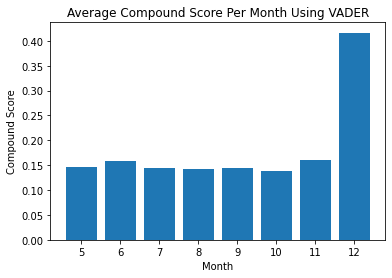

In [38]:
plt.bar(months, scores_per_month)
plt.xlabel('Month')
plt.ylabel('Compound Score')
plt.title('Average Compound Score Per Month Using VADER')
plt.show()

Let's try to see the distribution of positive, neutral, and negative tweets.

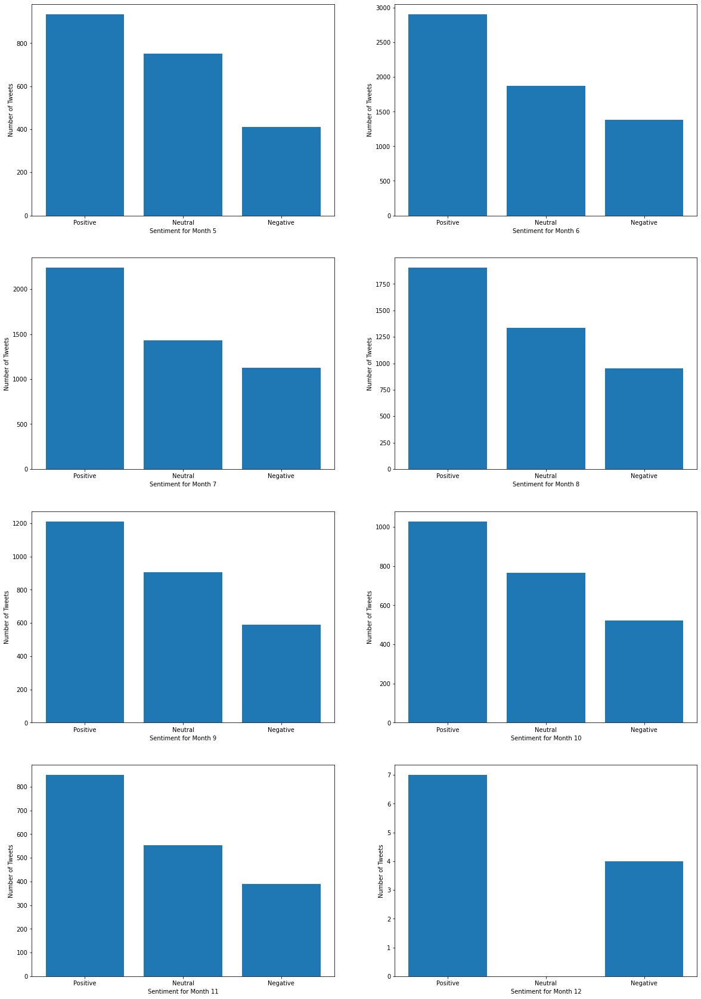

In [39]:
fig, axes = plt.subplots(4, 2, figsize=(20, 30))
x_label = ['Positive', 'Neutral', 'Negative']
i, j = 0, 0
for k in range(len(months)):
    y_value = [pos_num_tweets_per_month[k], neu_num_tweets_per_month[k], neg_num_tweets_per_month[k]]
    if j == 2:
        i += 1
        j = 0
    axes[i, j].bar(x_label, y_value)
    axes[i, j].set_xlabel(f'Sentiment for Month {months[k]}')
    axes[i, j].set_ylabel('Number of Tweets')
    j += 1
plt.show()

In [40]:
for i in range(len(months)):
    print(f'Month: {months[i]} - Positive: {pos_num_tweets_per_month[i]}, Neutral: {neu_num_tweets_per_month[i]}, Negative: {neg_num_tweets_per_month[i]}')

Month: 5 - Positive: 934, Neutral: 750, Negative: 410
Month: 6 - Positive: 2907, Neutral: 1873, Negative: 1378
Month: 7 - Positive: 2237, Neutral: 1430, Negative: 1128
Month: 8 - Positive: 1903, Neutral: 1333, Negative: 954
Month: 9 - Positive: 1211, Neutral: 906, Negative: 588
Month: 10 - Positive: 1029, Neutral: 765, Negative: 523
Month: 11 - Positive: 850, Neutral: 554, Negative: 389
Month: 12 - Positive: 7, Neutral: 0, Negative: 4


There is a similar distribution of positive, neutral, and negative tweets (based on VADER) throughout the months. There's no neutral tweets found in December, but that's because December had only 11 tweets.

Now let's look at the top words for each month.

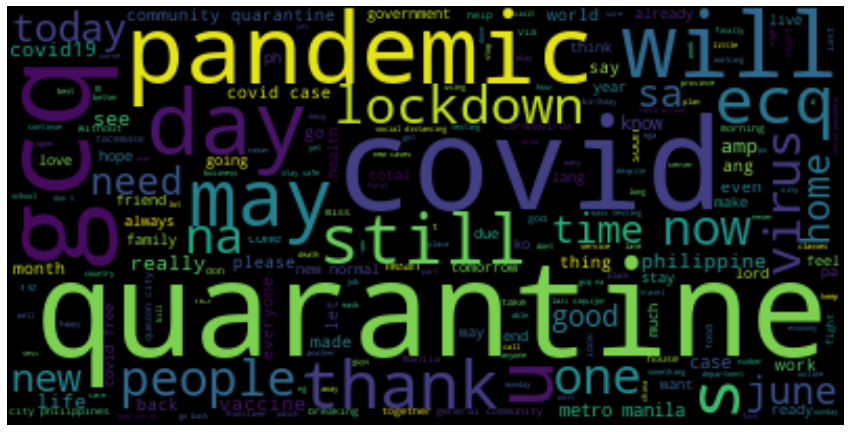

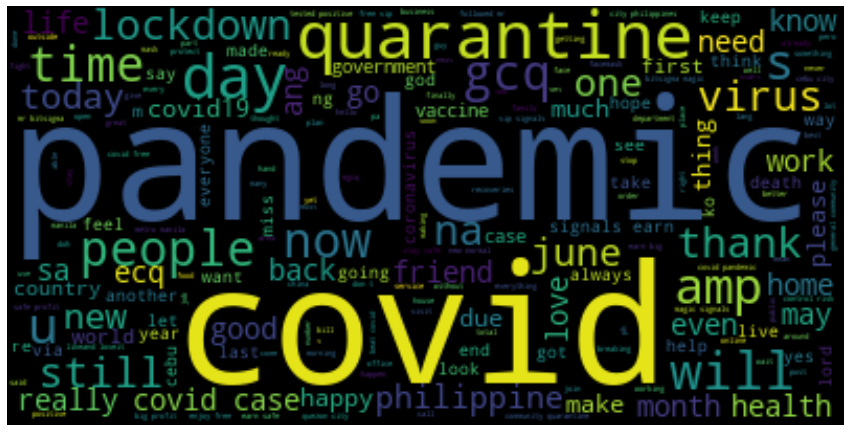

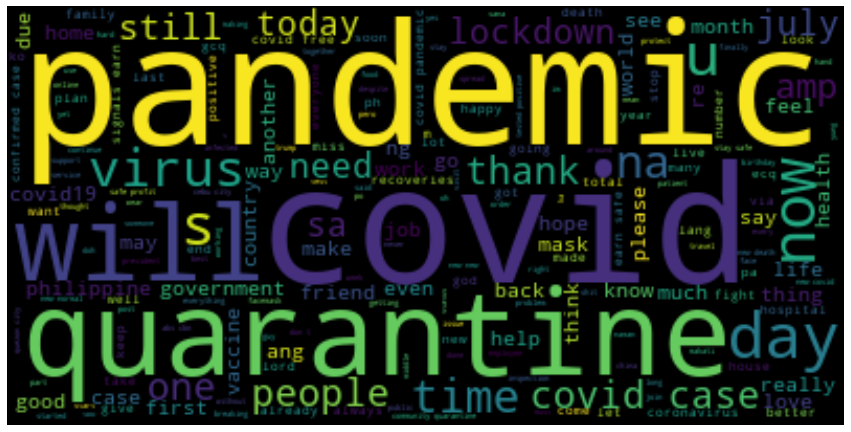

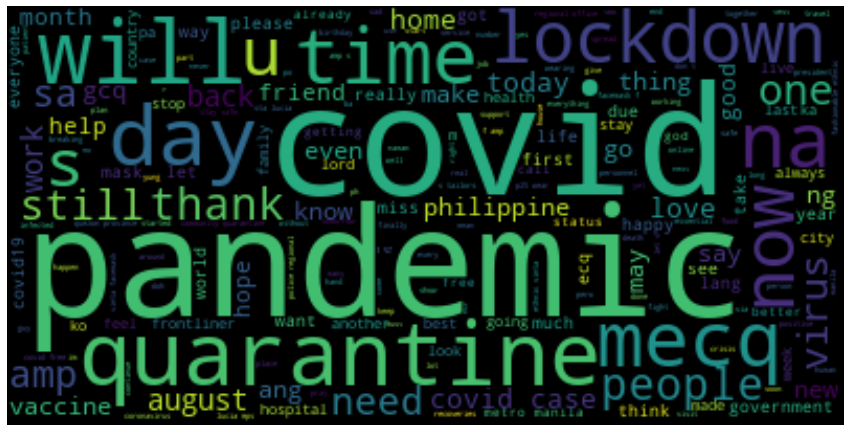

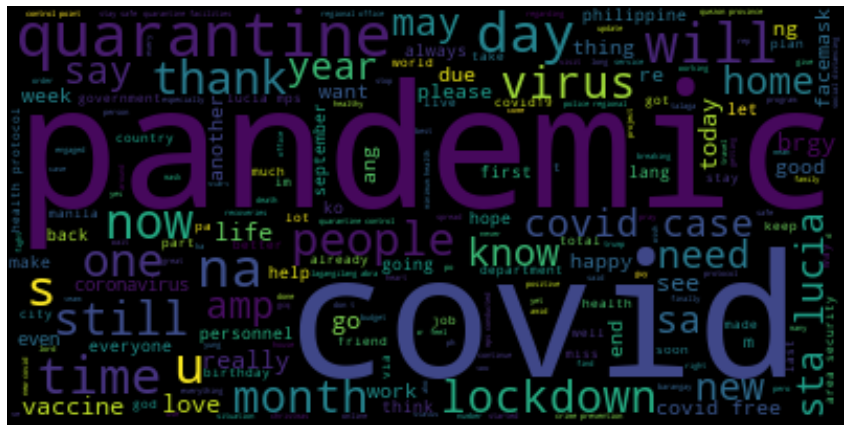

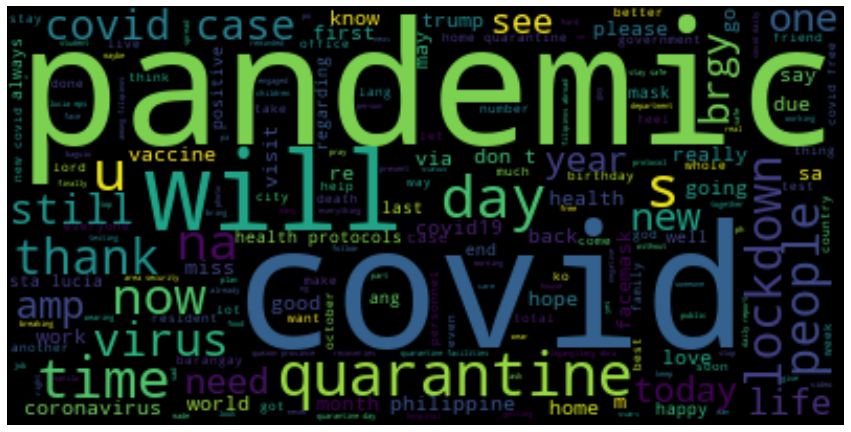

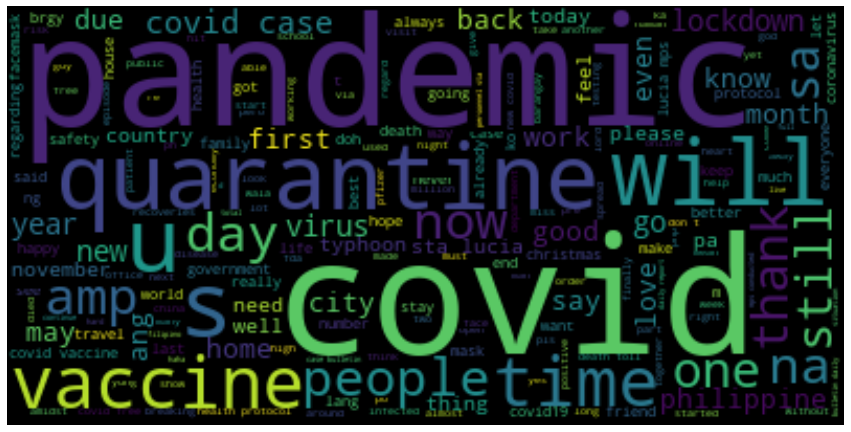

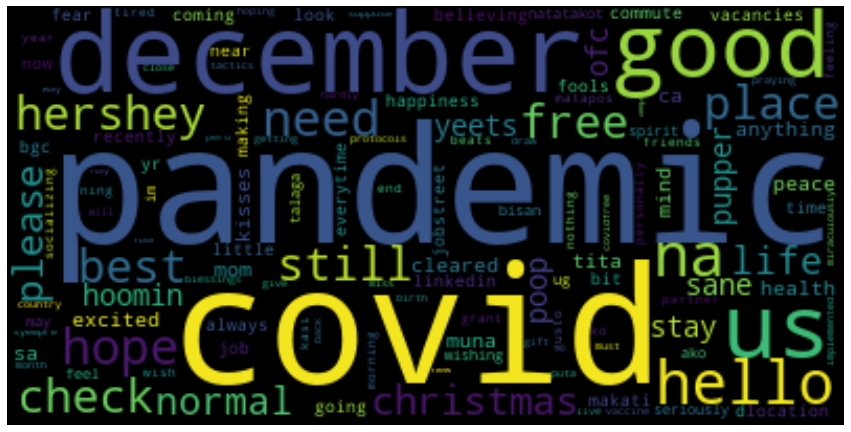

In [42]:
for i in range(len(top_words_per_month)):
    wc = WordCloud().generate(top_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()
    #plt.savefig('WordCloud/vader' + i + '.png')
    wc = wc.to_file('WordCloud/vader' + str(i) + '.png')

Let's look at the top words for positive, neutral, and negative tweets.

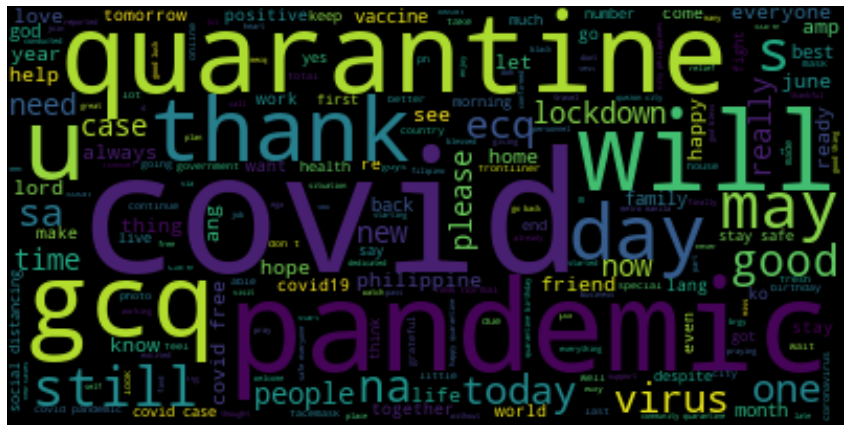

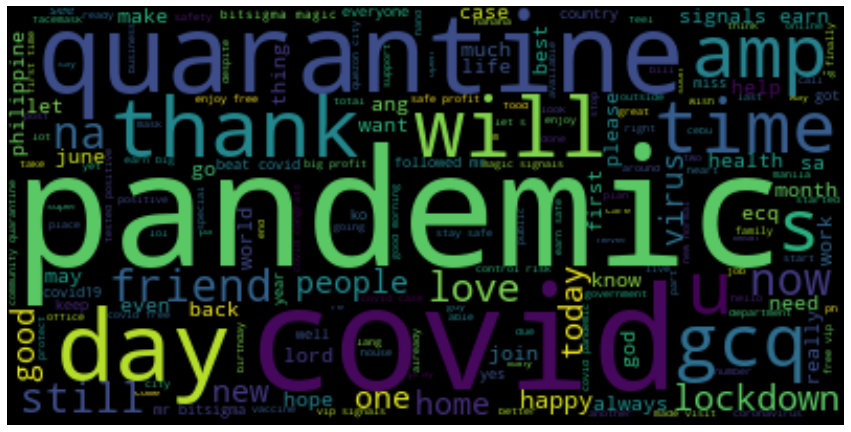

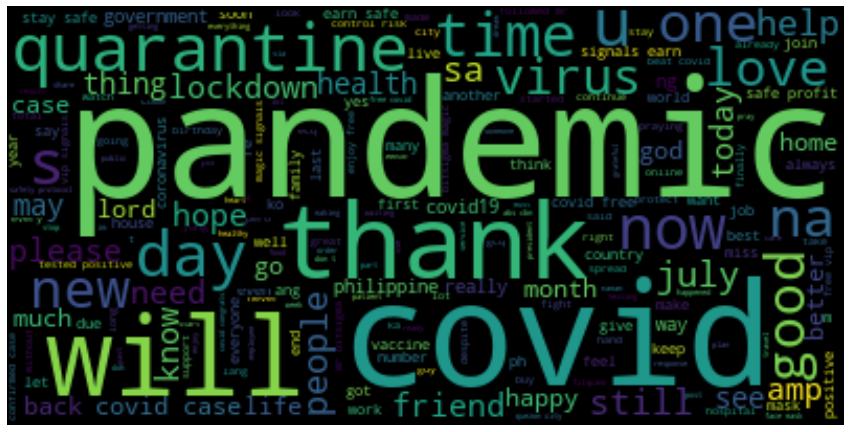

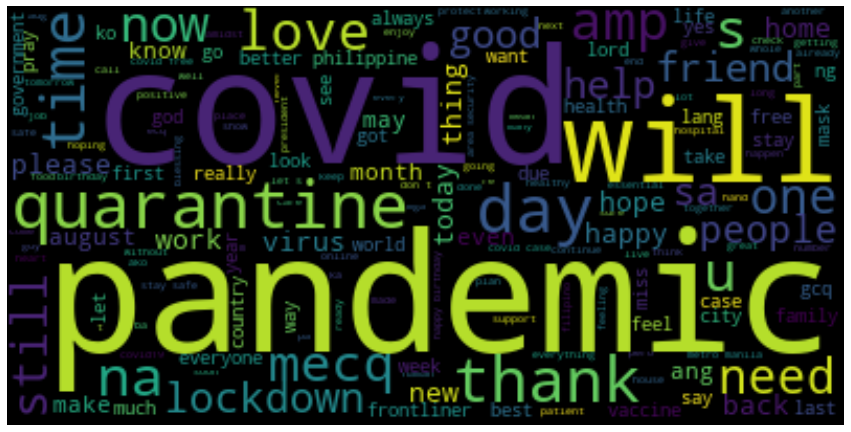

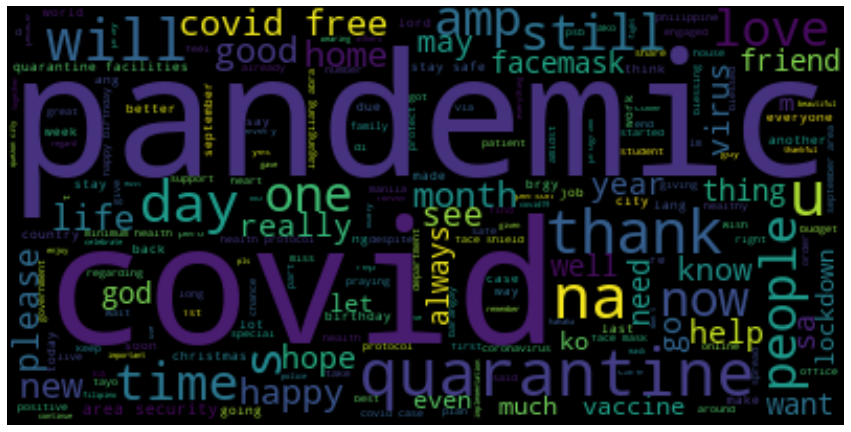

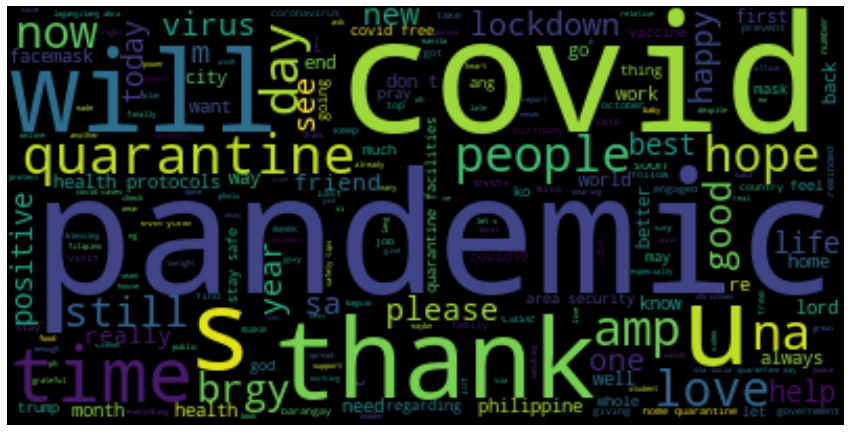

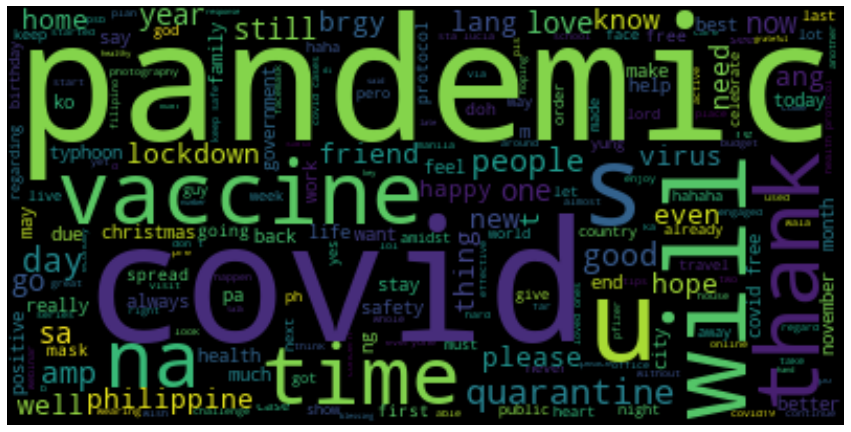

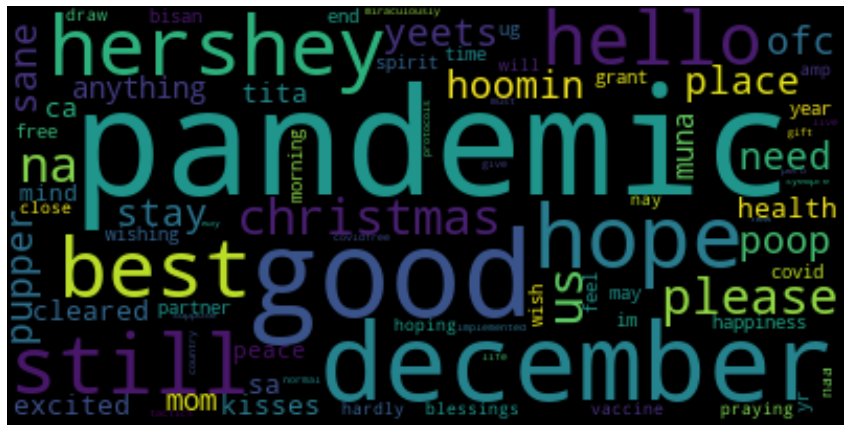

In [43]:
for i in range(len(pos_words_per_month)):
    wc = WordCloud().generate(pos_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

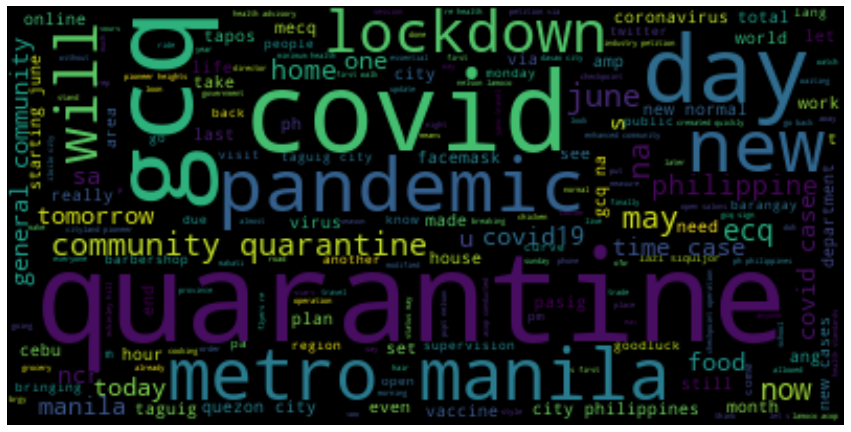

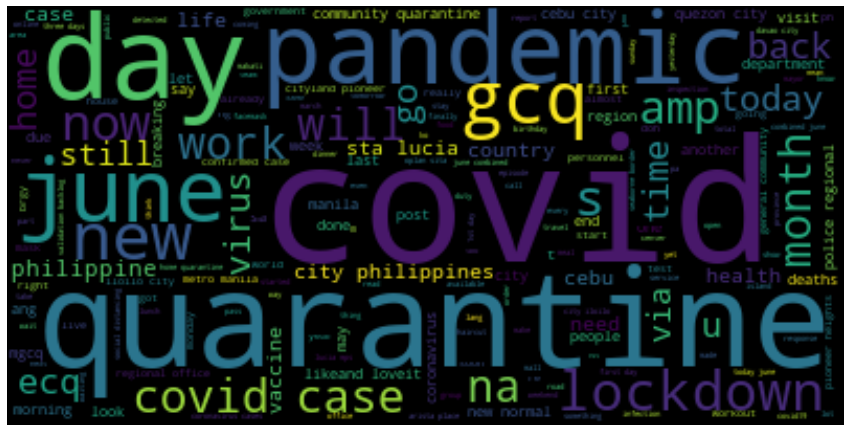

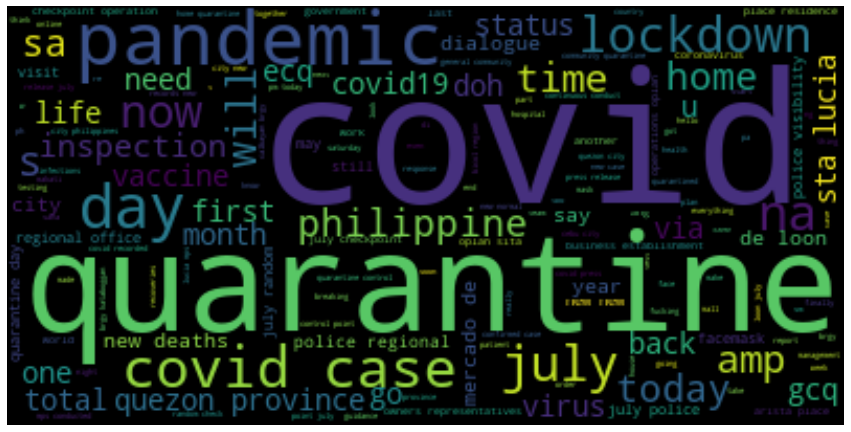

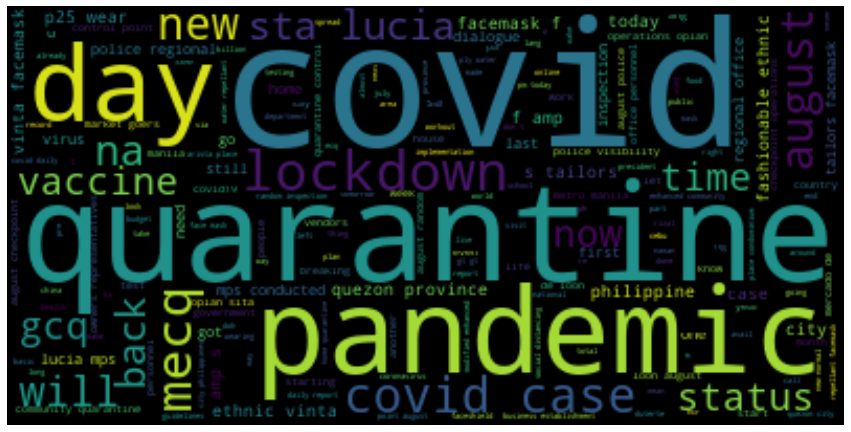

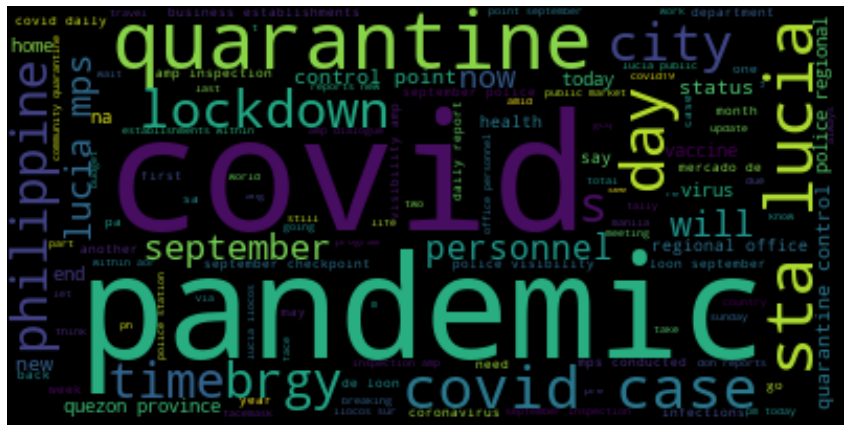

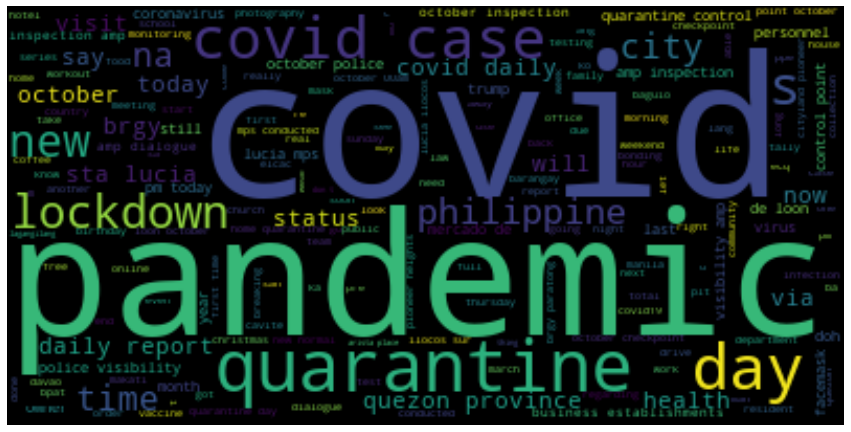

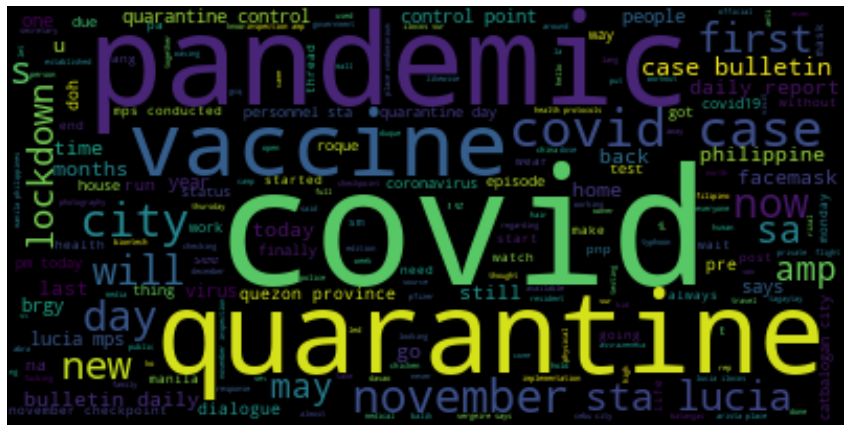

ValueError: We need at least 1 word to plot a word cloud, got 0.

In [44]:
for i in range(len(neu_words_per_month)):
    wc = WordCloud().generate(neu_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

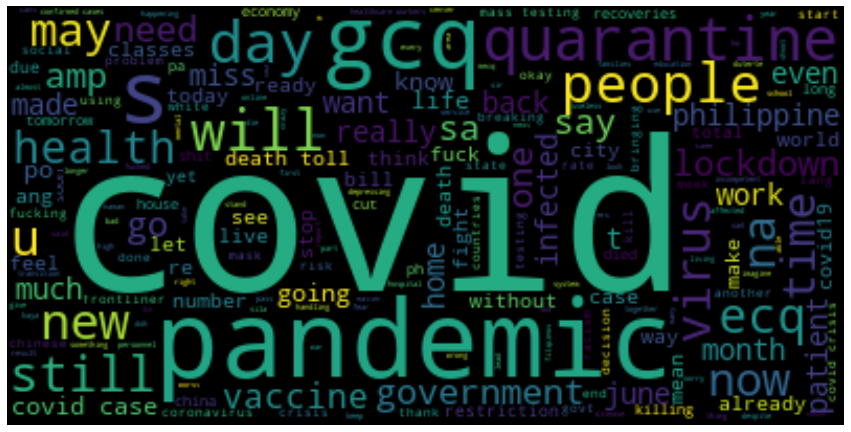

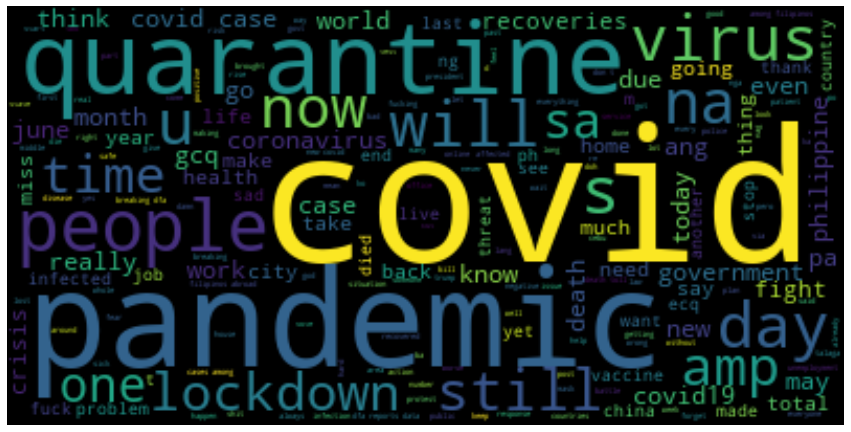

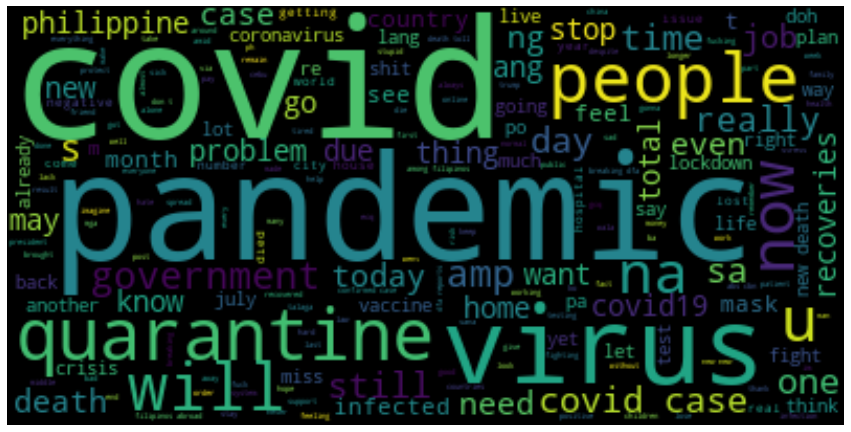

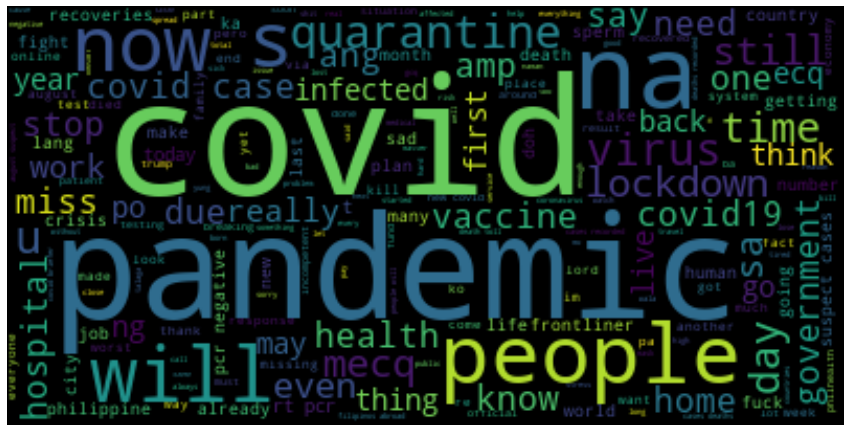

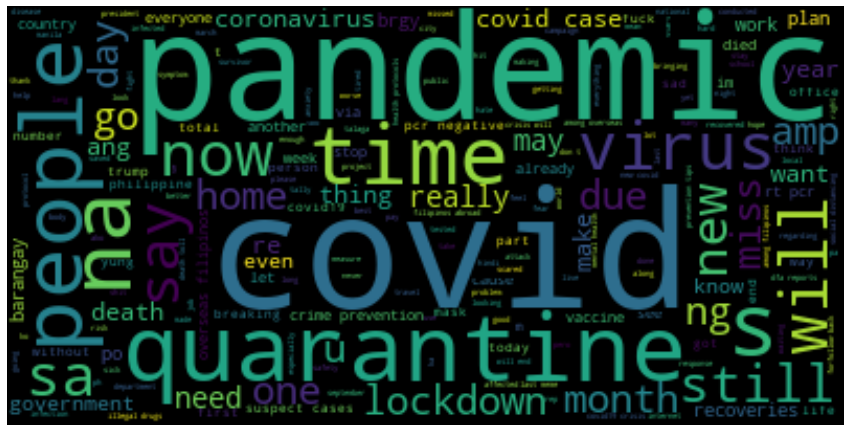

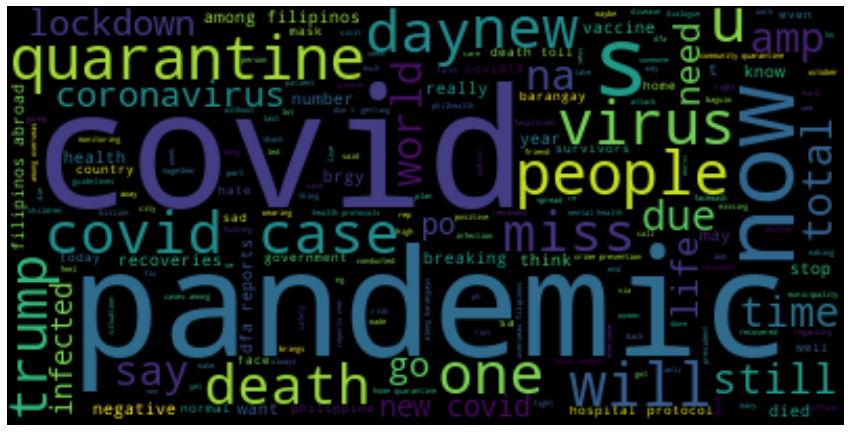

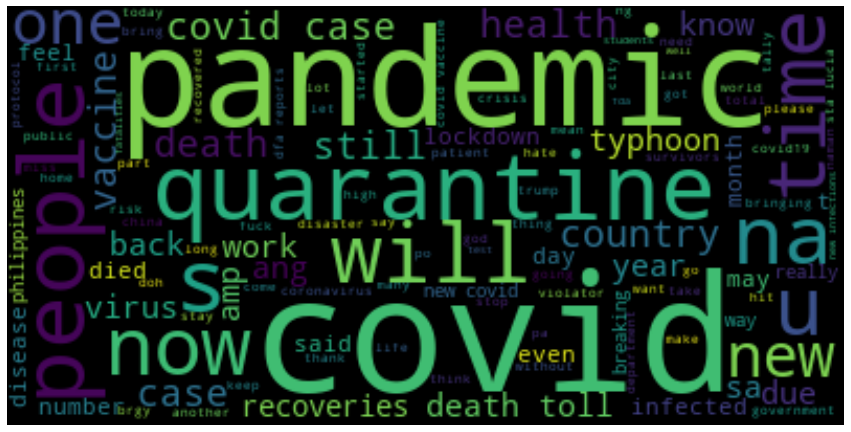

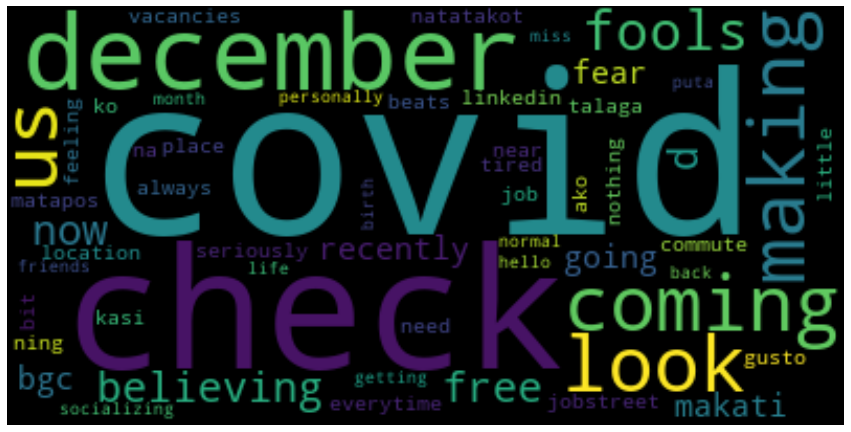

In [45]:
for i in range(len(neg_words_per_month)):
    wc = WordCloud().generate(neg_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

In [57]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['vader']['compound'] > 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

mask on amd stay safe!      sm cinema marilao 

 all hail foodpanda and the comfort it brings this quarantine.

birthday quarantine! happy birthday self 

happy eid mubarak to all muslims worldwide. feeling bless &amp; content that we still get to celebrate this festive season despite being under rmo and going through a pandemic. (feeling extra bless cause i got this cute baju raya last minute with such a good price!)  

this quarantine made me realized that not all people will care for you, even your friends and family will not understand you. at the end of the day, you only have yourself.

 the messaged and the melody of the song its so much powerful and it touches our hearts. i'm all the frontliners and nurses doctors are very motivated and encourage all the medical group to work together as one to defeat all the viruses and diseases. 

gabi na naman.    thank you, lord, for keeping me and my family safe. and so are my dear friends.   quezon city, philippines 

having to experience 

In [58]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['vader']['compound'] == 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

snack time from mcdonald's  when we crave for cheeseburger mcdo_ph i so likeand loveit...         … 

not in any way close to what i feel right now.  

      maripol sebastian  las piñas city         

quarantine food  chicken curry           

quarantine food  crispy kare kare          

quarantine food  crispy kare kare          

quarantine food  ham &amp; cheese rolls           

vlog no. 88 of  is out now on my youtube channel. click the link on my bio.    guadalupe makati 

arrived at my home town...  afterwards again for 14 days...  

before covid19, mabilis na yung 1.5hrs drive on a weekend/holiday  ngayun 32mins na lang, anytime/anyday! 

dialogue and distribution of fliers on anti-aterrorism campaign at loo, buguias, benguet.    



In [59]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['vader']['compound'] < 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

owwa administrator hans leo cacdac says the agency has spent over half a billion pesos helping overseas workers amid the covid-19 crisis. 

i want to remove my braces  covid stop na

day 69 of the restriction.                  

shoot and edit (2)   

shoot and edit    

when work stuff wants to fuck you up, it doesn’t matter whether it’s the weekend or holiday or when there’s friggin pandemic going on. 

  challenges and difficulties. while i acknowledge that it is okay not to be okay. we can never dwell on not being okay forever.  do you know my greatest fear in this pandemic?  it’s not the fear of contracting covid but the fear of the day when you are taking your licensure exam

  and you will say, “di ko to alam”, “di namin to napag-aralan”, “di naman ito naituro”, and the worst “day wala naman kami natutunan”.   it had been difficult in this time. you have yet to experience many things but this pandemic came.  i am sorry    sorry, that you experience

tbh i am enjoying watch the g

# TextBlob
Similarly to VADER, we use TextBlob, another library for sentiment analysis to see if the sentiment VADER provided is similar. The procedure in VADER is also applied here in the new few cells to see the top words, positive words, neutral words and negative words per month.

In [60]:
blob_polarity = []
blob_subjectivity = []

for i in range(len(covid_df)):
    blob_polarity.append(TextBlob(covid_df.loc[i]['clean_text']).sentiment.polarity)
    blob_subjectivity.append(TextBlob(covid_df.loc[i]['clean_text']).sentiment.subjectivity)
    
polarity_array = np.array(blob_polarity)
subjectivity_array = np.array(blob_subjectivity)

covid_df['blob_polarity'] = polarity_array
covid_df['blob_subjectivity'] = subjectivity_array
covid_df.head(2)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens,vader,blob_polarity,blob_subjectivity
0,1.264847e+18,459997572.0,2020-05-25 17:14:56,en,Snack Time🥤🍝🍔🍟 from McDonald's when we crave ...,snack time from mcdonald's when we crave for ...,5,25,2020,"[#photooftheday, #mcdonalds, #mcdoph, #lovekot...","[snack, time, from, mcdonald, 's, when, we, cr...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.000000,0.000000
1,1.264847e+18,56951008.0,2020-05-25 17:15:10,en,Not in any way close to what I feel right now....,not in any way close to what i feel right now.,5,25,2020,[#quarantinecover],"[not, in, any, way, close, to, what, i, feel, ...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.285714,0.535714


In [ ]:
scores_per_month = []
top_words_per_month = []
pos_words_per_month = []
neu_words_per_month = []
neg_words_per_month = []
pos_num_tweets_per_month = []
neu_num_tweets_per_month = []
neg_num_tweets_per_month = []

for month in months:
    score = 0
    num_tweets = 0
    pos_tweets = 0
    neu_tweets = 0
    neg_tweets = 0
    words = ''
    pos_words = ''
    neu_words = ''
    neg_words = ''
    for i in range(len(covid_df)):
        if covid_df.loc[i]['month'] == month:
            score += covid_df.loc[i]['blob_polarity']
            num_tweets += 1
            words += covid_df.loc[i]['clean_text']
            if covid_df.loc[i]['blob_polarity'] > 0:
                pos_words += covid_df.loc[i]['clean_text']
                pos_tweets += 1
            elif covid_df.loc[i]['blob_polarity'] == 0:
                neu_words += covid_df.loc[i]['clean_text']
                neu_tweets += 1
            elif covid_df.loc[i]['blob_polarity'] < 0:
                neg_words += covid_df.loc[i]['clean_text']
                neg_tweets += 1
    top_words_per_month.append(words)
    pos_words_per_month.append(pos_words)
    neu_words_per_month.append(neu_words)
    neg_words_per_month.append(neg_words)
    pos_num_tweets_per_month.append(pos_tweets)
    neu_num_tweets_per_month.append(neu_tweets)
    neg_num_tweets_per_month.append(neg_tweets)
    print(f'Month {month}: Compound score: {score} / Num. of tweets: {num_tweets} = Average compound score: {score/num_tweets}')
    scores_per_month.append(score/num_tweets)

Month 5: Compound score: 225.27553016339226 / Num. of tweets: 2094 = Average compound score: 0.10758143751833442
Month 6: Compound score: 668.9148179924965 / Num. of tweets: 6158 = Average compound score: 0.10862533582210077
Month 7: Compound score: 464.9766862955667 / Num. of tweets: 4795 = Average compound score: 0.09697115459761559
Month 8: Compound score: 380.8550724971914 / Num. of tweets: 4190 = Average compound score: 0.09089619868668052
Month 9: Compound score: 243.13560134067217 / Num. of tweets: 2705 = Average compound score: 0.08988377129045182
Month 10: Compound score: 199.66882820732513 / Num. of tweets: 2317 = Average compound score: 0.08617558403423614
Month 11: Compound score: 209.3169492948903 / Num. of tweets: 1793 = Average compound score: 0.1167411875598942
Month 12: Compound score: 2.737878787878788 / Num. of tweets: 11 = Average compound score: 0.24889807162534436


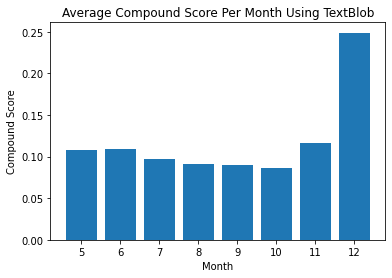

In [73]:
plt.bar(months, scores_per_month)
plt.xlabel('Month')
plt.ylabel('Compound Score')
plt.title('Average Compound Score Per Month Using TextBlob')
plt.show()

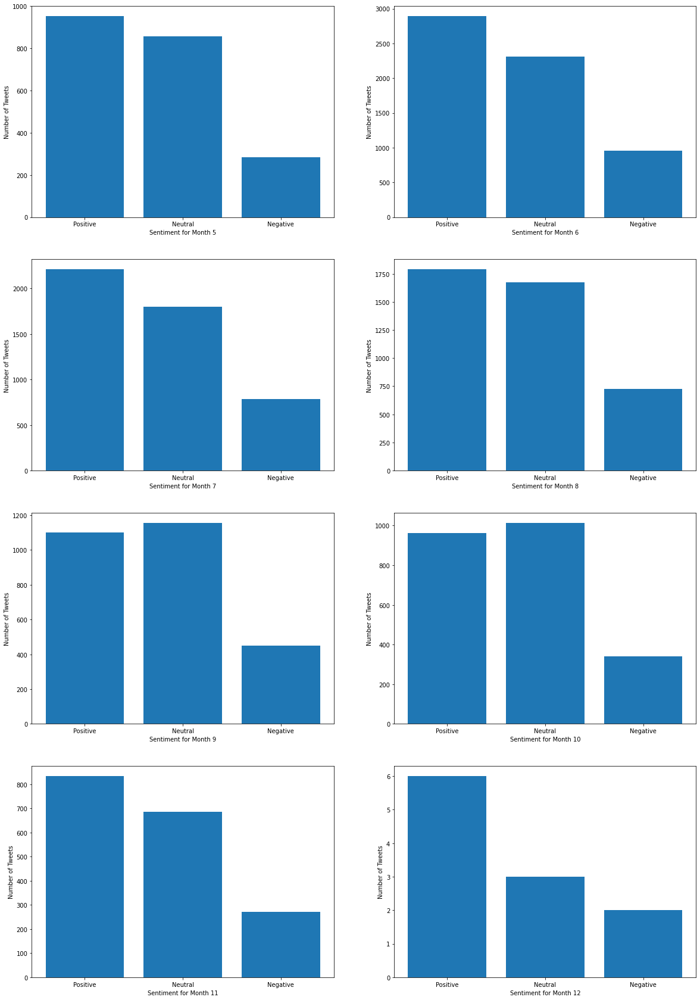

In [74]:
fig, axes = plt.subplots(4, 2, figsize=(20, 30))
x_label = ['Positive', 'Neutral', 'Negative']
i, j = 0, 0
for k in range(len(months)):
    y_value = [pos_num_tweets_per_month[k], neu_num_tweets_per_month[k], neg_num_tweets_per_month[k]]
    if j == 2:
        i += 1
        j = 0
    axes[i, j].bar(x_label, y_value)
    axes[i, j].set_xlabel(f'Sentiment for Month {months[k]}')
    axes[i, j].set_ylabel('Number of Tweets')
    j += 1
plt.show()

In [75]:
for i in range(len(months)):
    print(f'Month: {months[i]} - Positive: {pos_num_tweets_per_month[i]}, Neutral: {neu_num_tweets_per_month[i]}, Negative: {neg_num_tweets_per_month[i]}')

Month: 5 - Positive: 953, Neutral: 857, Negative: 284
Month: 6 - Positive: 2894, Neutral: 2306, Negative: 958
Month: 7 - Positive: 2210, Neutral: 1798, Negative: 787
Month: 8 - Positive: 1790, Neutral: 1675, Negative: 725
Month: 9 - Positive: 1100, Neutral: 1156, Negative: 449
Month: 10 - Positive: 963, Neutral: 1014, Negative: 340
Month: 11 - Positive: 834, Neutral: 687, Negative: 272
Month: 12 - Positive: 6, Neutral: 3, Negative: 2


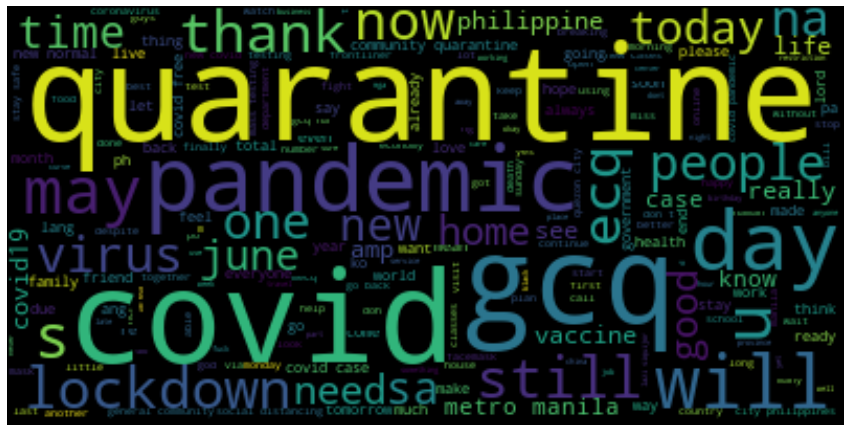

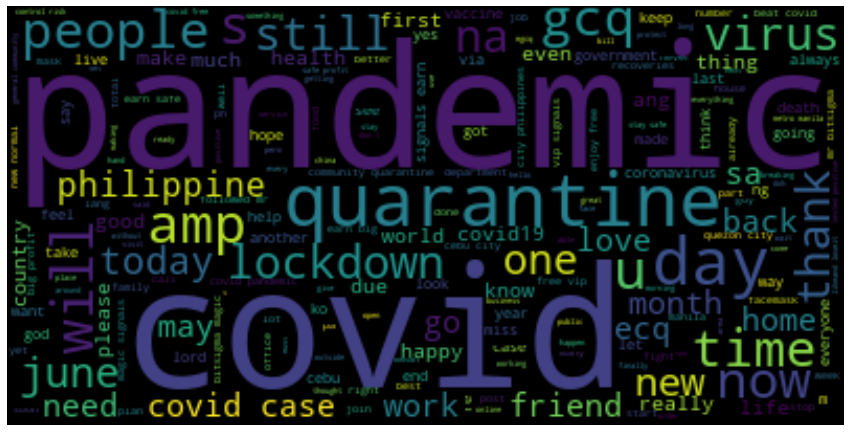

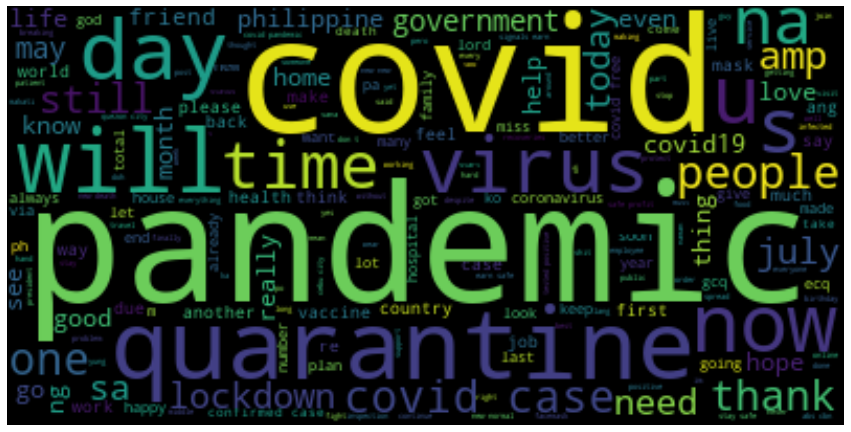

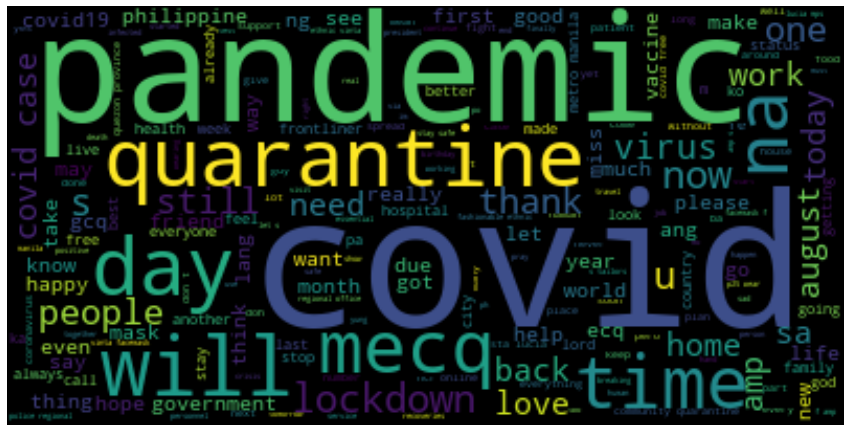

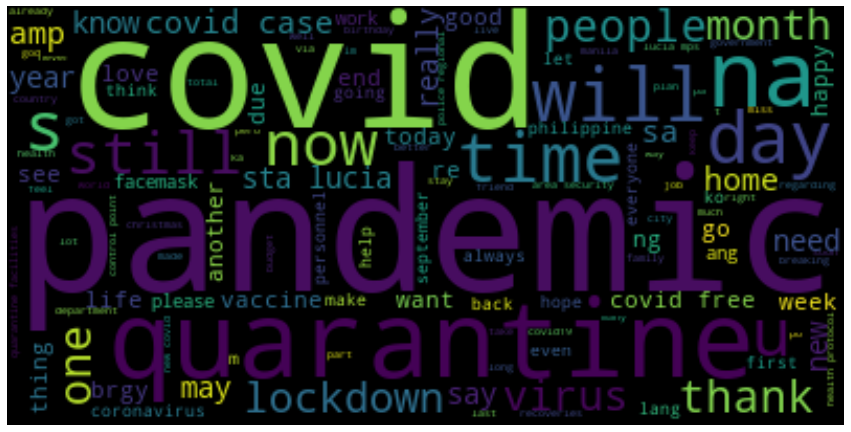

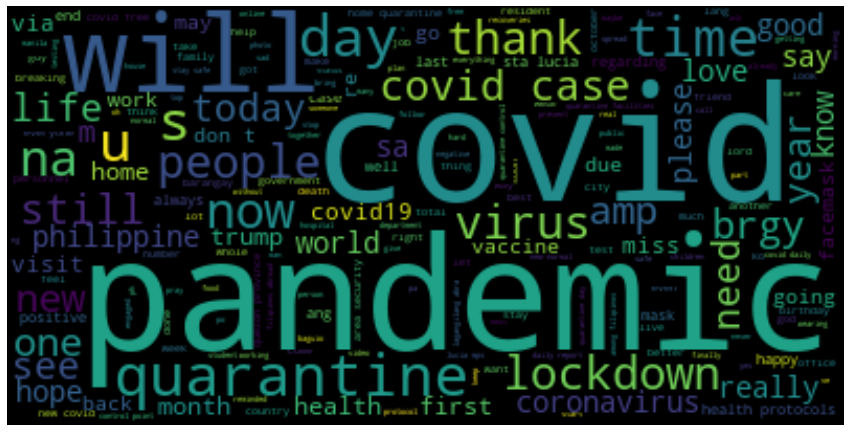

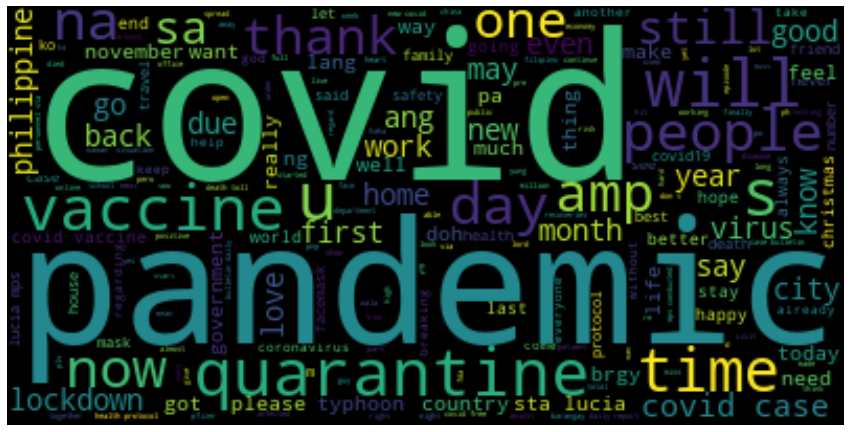

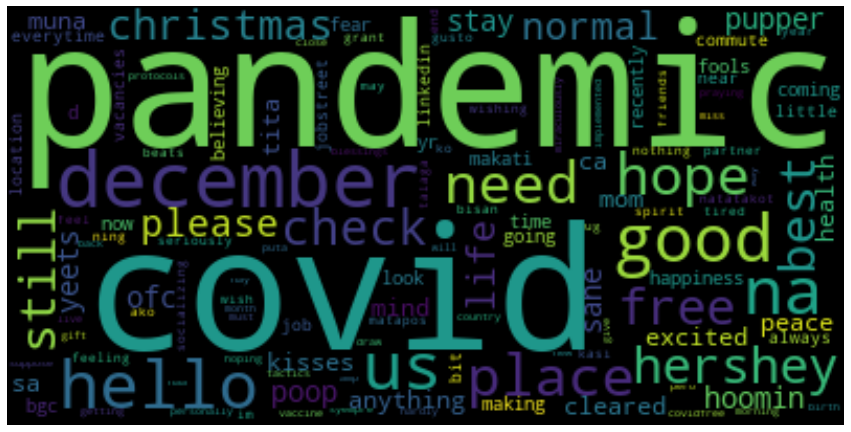

In [77]:
for i in range(len(top_words_per_month)):
    wc = WordCloud().generate(top_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()
    wc = wc.to_file('WordCloud/textblob' + str(i) + '.png')

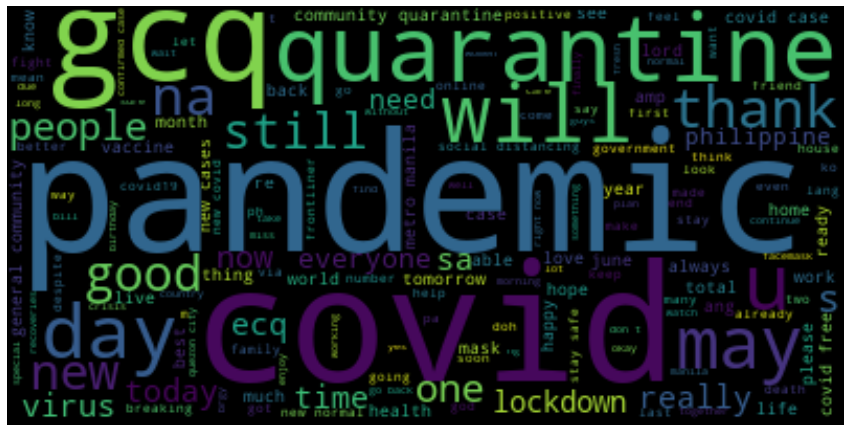

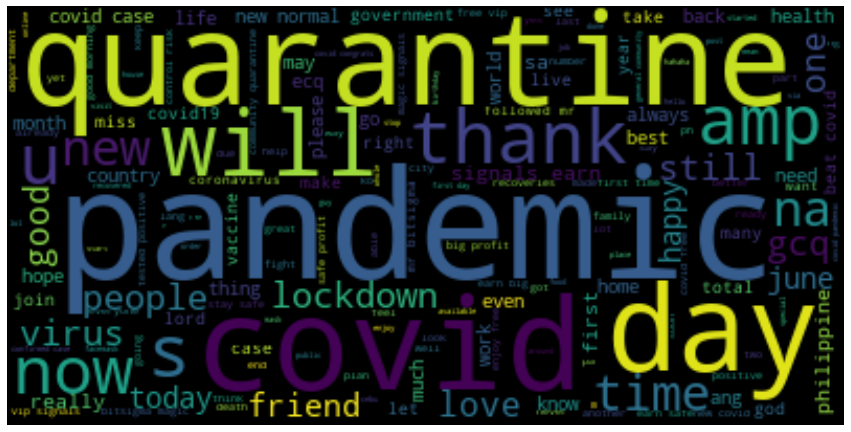

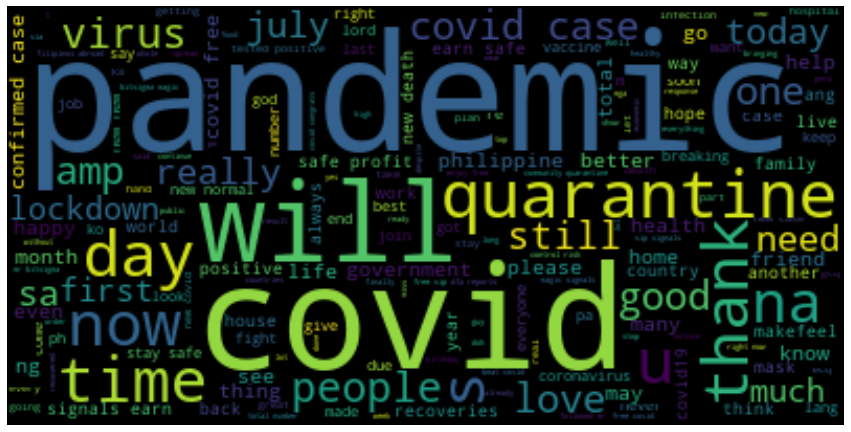

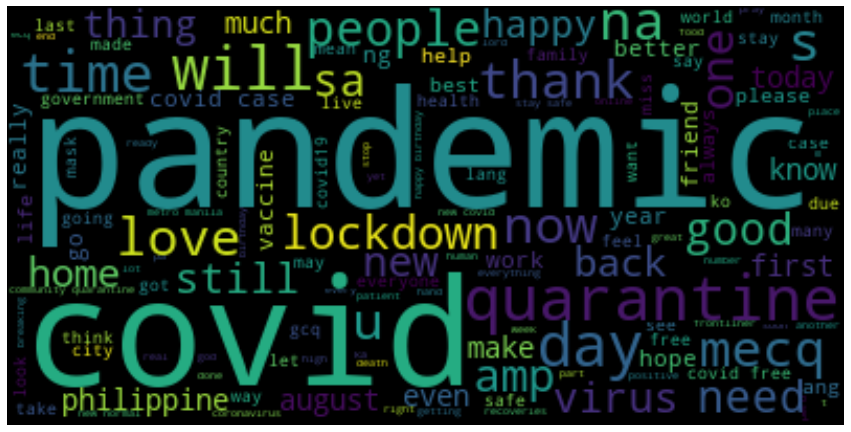

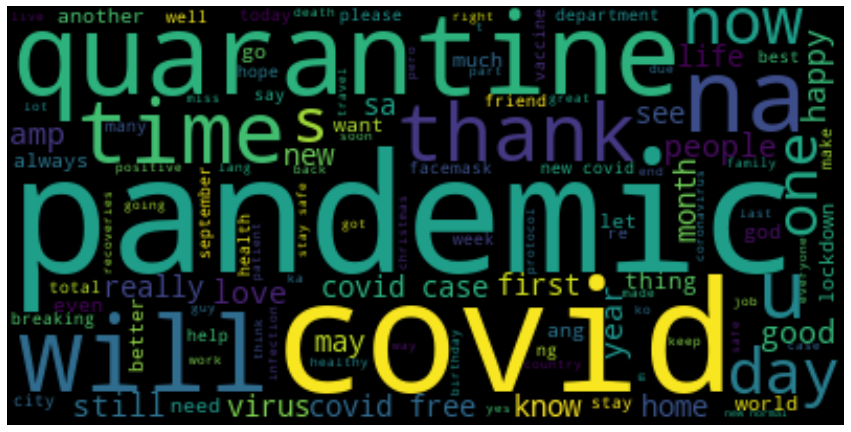

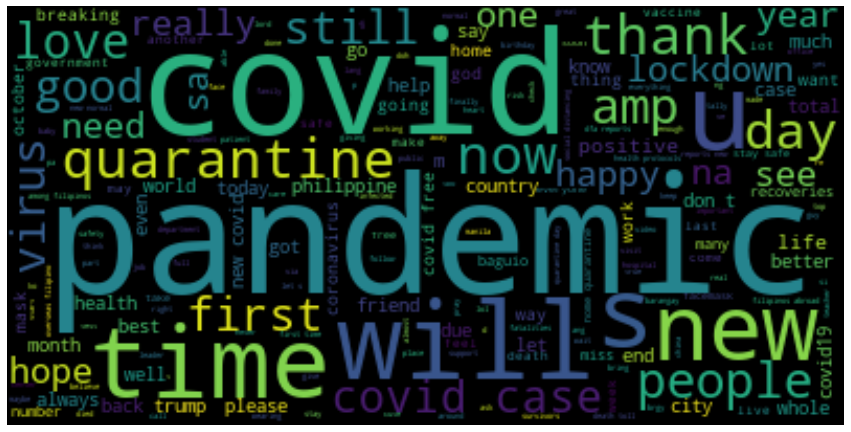

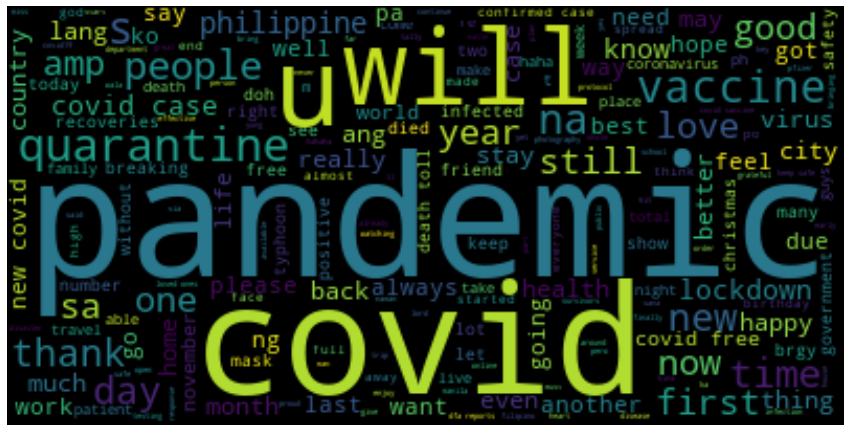

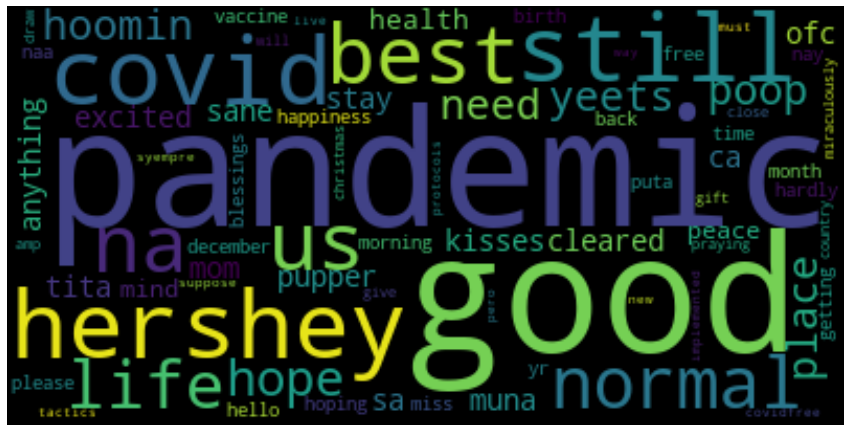

In [78]:
for i in range(len(pos_words_per_month)):
    wc = WordCloud().generate(pos_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

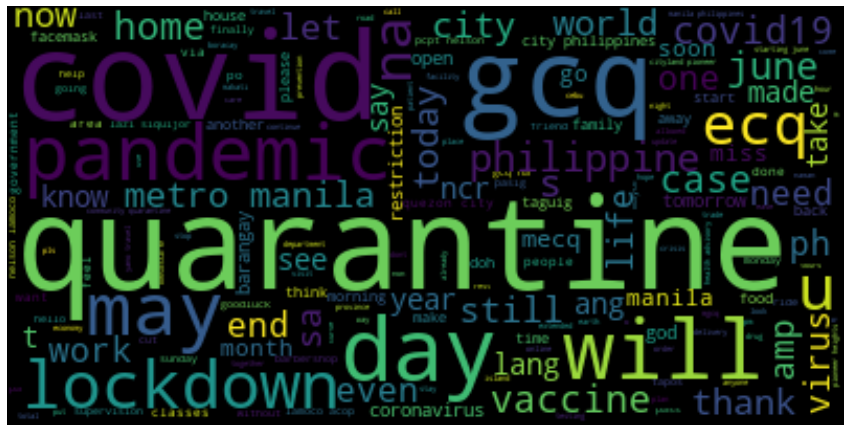

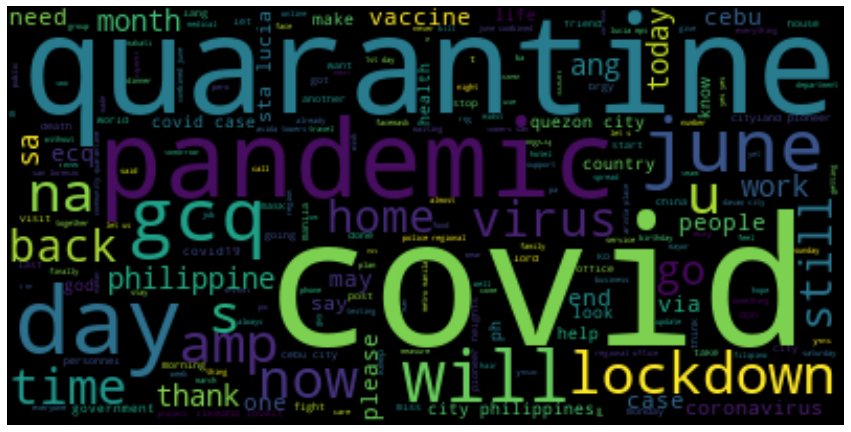

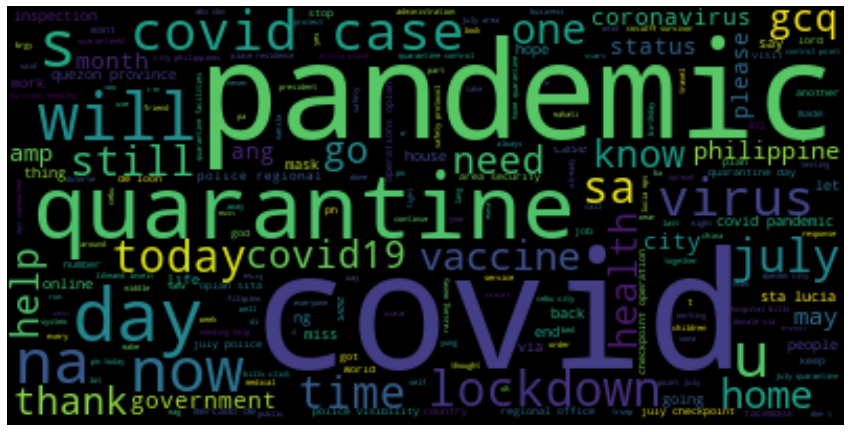

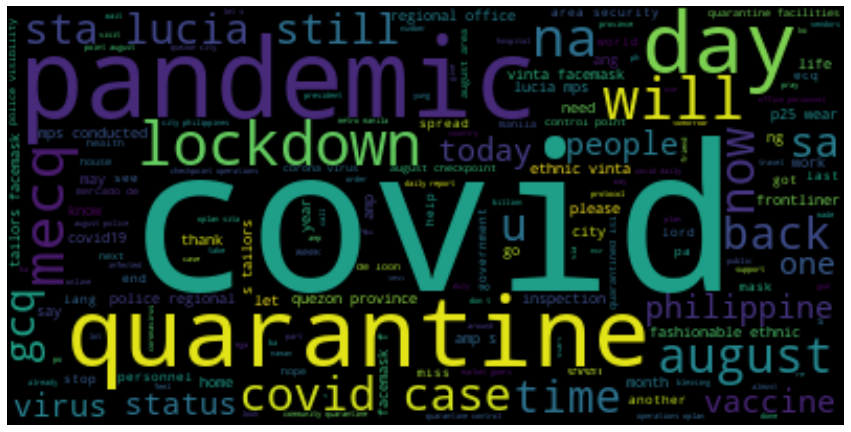

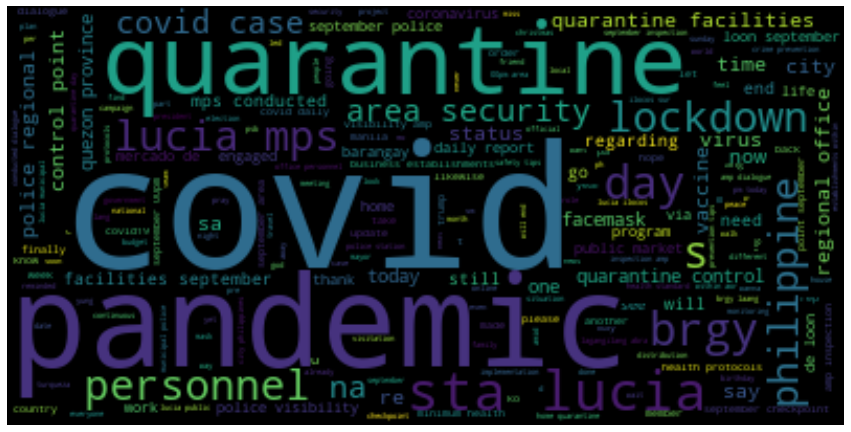

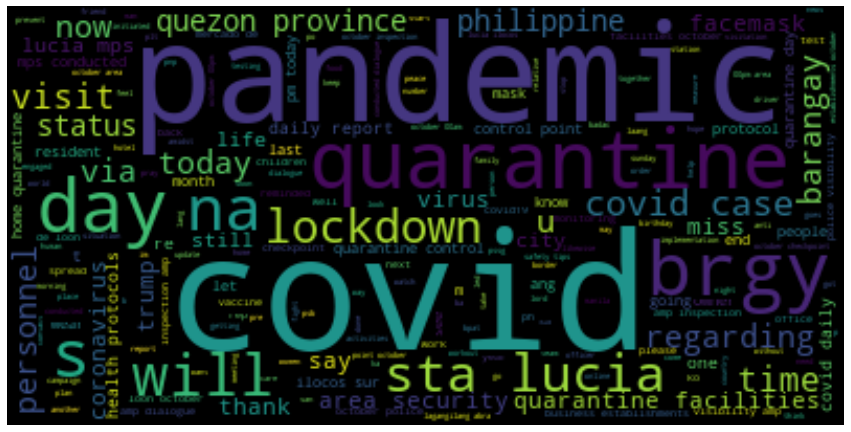

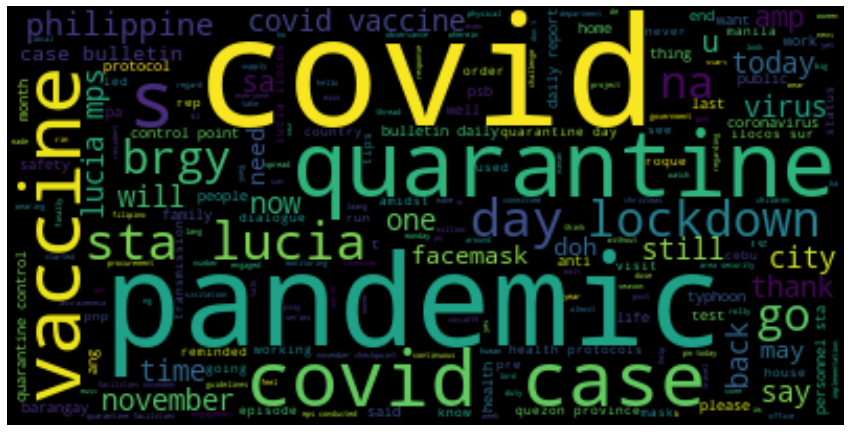

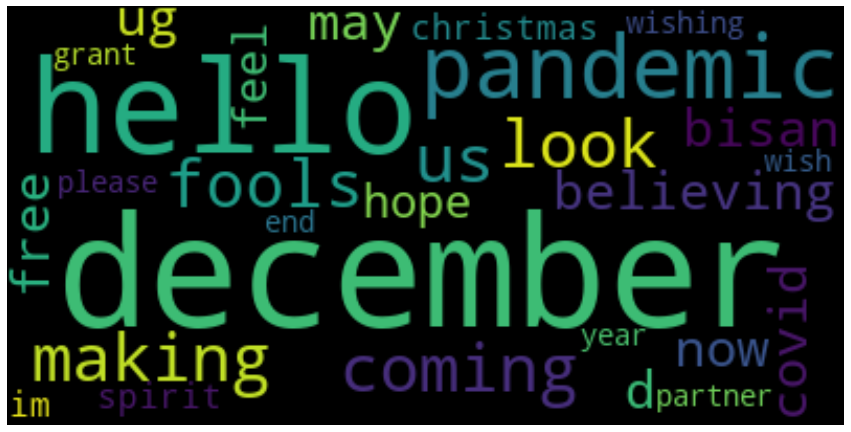

In [79]:
for i in range(len(neu_words_per_month)):
    wc = WordCloud().generate(neu_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

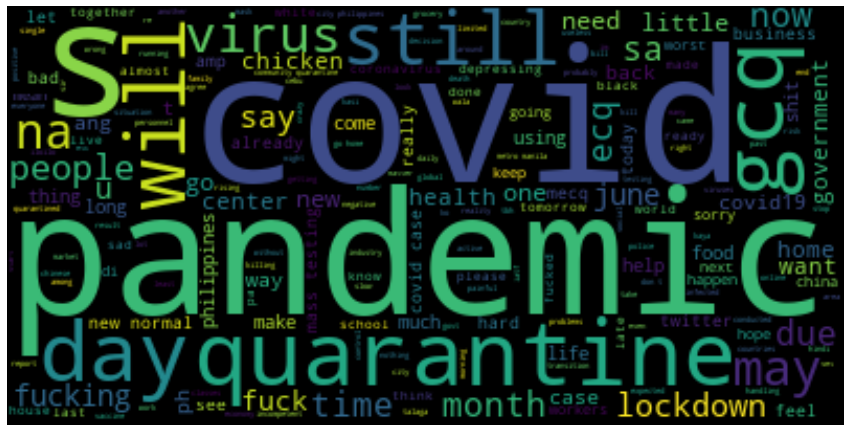

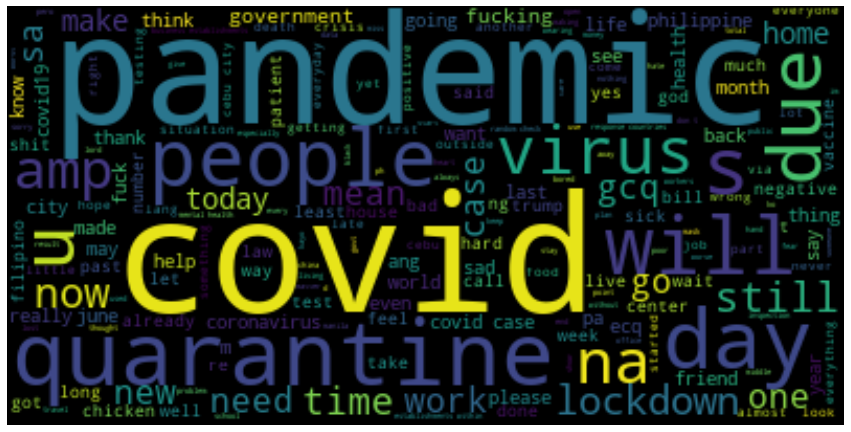

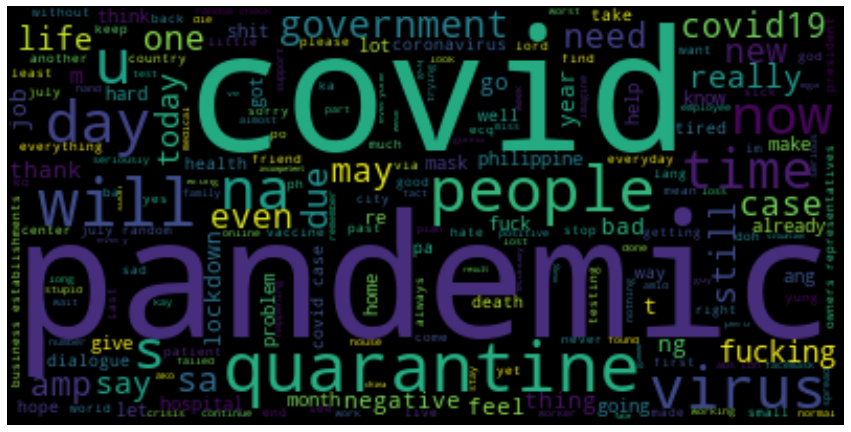

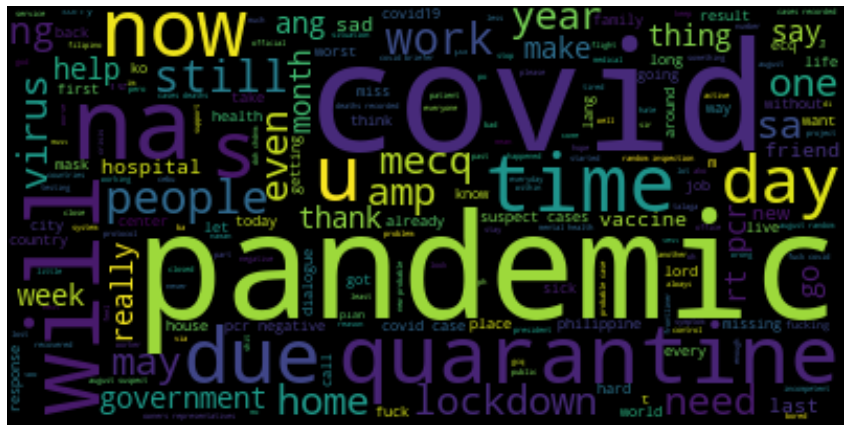

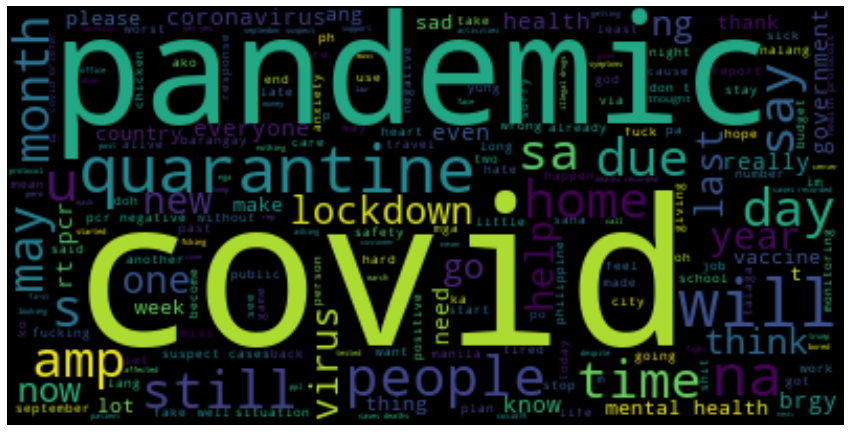

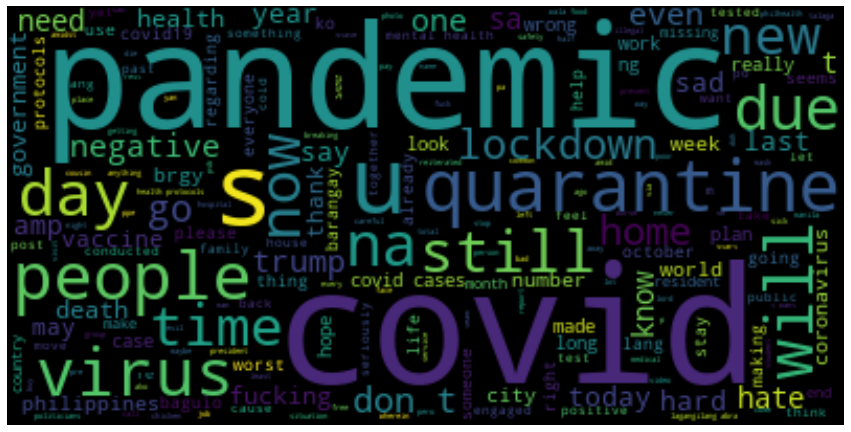

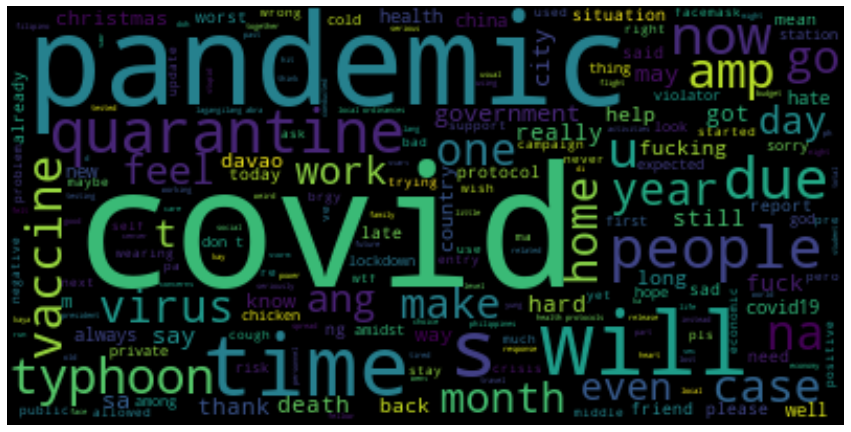

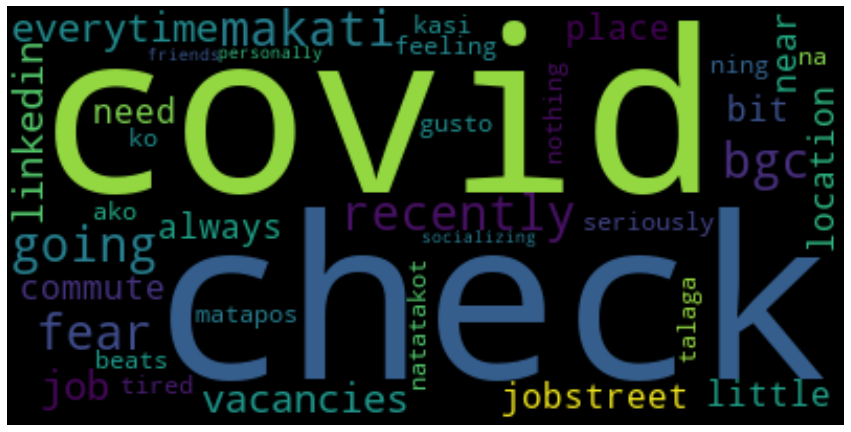

In [80]:
for i in range(len(neg_words_per_month)):
    wc = WordCloud().generate(neg_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

In [81]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['blob_polarity'] > 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

not in any way close to what i feel right now.  

mask on amd stay safe!      sm cinema marilao 

birthday quarantine! happy birthday self 

happy eid mubarak to all muslims worldwide. feeling bless &amp; content that we still get to celebrate this festive season despite being under rmo and going through a pandemic. (feeling extra bless cause i got this cute baju raya last minute with such a good price!)  

 more tawa days witchu after quarantine 

 the messaged and the melody of the song its so much powerful and it touches our hearts. i'm all the frontliners and nurses doctors are very motivated and encourage all the medical group to work together as one to defeat all the viruses and diseases. 

first quarantine   greenfield district 

gabi na naman.    thank you, lord, for keeping me and my family safe. and so are my dear friends.   quezon city, philippines 

having to experience the effects of a global pandemic made me realize that i’ve been taking so many things for granted. we’ve 

In [82]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['blob_polarity'] == 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

snack time from mcdonald's  when we crave for cheeseburger mcdo_ph i so likeand loveit...         … 

      maripol sebastian  las piñas city         

quarantine food  crispy kare kare          

 all hail foodpanda and the comfort it brings this quarantine.

quarantine food  crispy kare kare          

quarantine food  ham &amp; cheese rolls           

vlog no. 88 of  is out now on my youtube channel. click the link on my bio.    guadalupe makati 

i want to remove my braces  covid stop na

arrived at my home town...  afterwards again for 14 days...  

before covid19, mabilis na yung 1.5hrs drive on a weekend/holiday  ngayun 32mins na lang, anytime/anyday! 

dialogue and distribution of fliers on anti-aterrorism campaign at loo, buguias, benguet.    



In [83]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['blob_polarity'] < 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

quarantine food  chicken curry           

owwa administrator hans leo cacdac says the agency has spent over half a billion pesos helping overseas workers amid the covid-19 crisis. 

when work stuff wants to fuck you up, it doesn’t matter whether it’s the weekend or holiday or when there’s friggin pandemic going on. 

  and you will say, “di ko to alam”, “di namin to napag-aralan”, “di naman ito naituro”, and the worst “day wala naman kami natutunan”.   it had been difficult in this time. you have yet to experience many things but this pandemic came.  i am sorry    sorry, that you experience

mental health is probably the next pandemic.

little baker..  whipped up some brownies with this little one..         holy spirit village 

lockdown afternoon hits    rode our bikes  around the village (wearing our masks and staying socially distant!!) and when we reached the park with no one around, he removed his mask.. me: zachy! wear your… 

sorry for flooding u all abt my workouts, pics, etc.

In [134]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['vader']['compound'] > 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

mask on amd stay safe!      sm cinema marilao 

 all hail foodpanda and the comfort it brings this .

birthday ! happy birthday self 

happy eid mubarak to all muslims worldwide. feeling bless &amp; content that we still get to celebrate this festive season despite being under rmo and going through a . (feeling extra bless cause i got this cute baju raya last minute with such a good price!)  

this  made me realized that not all people will care for you, even your friends and family will not understand you. at the end of the day, you only have yourself.

 the messaged and the melody of the song its so much powerful and it touches our hearts. i'm all the frontliners and nurses doctors are very motivated and encourage all the medical group to work together as one to defeat all the es and diseases. 

gabi na naman.    thank you, lord, for keeping me and my family safe. and so are my dear friends.   quezon city, philippines 

having to experience the effects of a global  made me realize th

In [137]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['vader']['compound'] == 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

snack time from mcdonald's  when we crave for cheeseburger mcdo_ph i so likeand loveit...         … 

not in any way close to what i feel right now.  

      maripol sebastian  las piñas city         

 food  chicken curry           

 food  crispy kare kare          

 food  crispy kare kare          

 food  ham &amp; cheese rolls           

vlog no. 88 of  is out now on my youtube channel. click the link on my bio.    guadalupe makati 

arrived at my home town...  afterwards again for 14 days...  

before 19, mabilis na yung 1.5hrs drive on a weekend/holiday  ngayun 32mins na lang, anytime/anyday! 

dialogue and distribution of fliers on anti-aterrorism campaign at loo, buguias, benguet.    



In [138]:
limit = 0
for i in range(len(covid_df)):
    if covid_df.loc[i]['vader']['compound'] < 0:
        print(covid_df.loc[i]['clean_text'])
        print('')
        if limit == 10:
            break
        else:
            limit += 1

owwa administrator hans leo cacdac says the agency has spent over half a billion pesos helping overseas workers amid the -19 crisis. 

i want to remove my braces   stop na

day 69 of the restriction.                  

shoot and edit (2)   

shoot and edit    

when work stuff wants to fuck you up, it doesn’t matter whether it’s the weekend or holiday or when there’s friggin  going on. 

  challenges and difficulties. while i acknowledge that it is okay not to be okay. we can never dwell on not being okay forever.  do you know my greatest fear in this ?  it’s not the fear of contracting  but the fear of the day when you are taking your licensure exam

  and you will say, “di ko to alam”, “di namin to napag-aralan”, “di naman ito naituro”, and the worst “day wala naman kami natutunan”.   it had been difficult in this time. you have yet to experience many things but this  came.  i am sorry    sorry, that you experience

tbh i am enjoying watch the german football but fans are missed. sho

## No list of words

Since we gathered tweets based on a list of words, we want to illustrate a wordcloud containing words that do not contain those select tokens for unbiased result. 

In [115]:
covid_nolist_df = covid_df

In [117]:
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'covid')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'pandemic')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'quarantine')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'vaccine')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'virus')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'lockdown')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'gcq')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'mecq')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'ecq')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'newnormal')
covid_nolist_df['clean_text'] = np.vectorize(remove_text_from_regex)(covid_nolist_df['clean_text'], r'facemask')

### Vader

In [118]:
vader = SentimentIntensityAnalyzer()
scores = []

for i in range(len(covid_nolist_df)):
    scores.append(vader.polarity_scores(covid_nolist_df.loc[i]['clean_text']))
    
scores_array = np.array(scores, dtype=object)
covid_nolist_df['vader'] = scores_array
covid_nolist_df.head(2)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens,vader,blob_polarity,blob_subjectivity
0,1.264847e+18,459997572.0,2020-05-25 17:14:56,en,Snack Time🥤🍝🍔🍟 from McDonald's when we crave ...,snack time from mcdonald's when we crave for ...,5,25,2020,"[#photooftheday, #mcdonalds, #mcdoph, #lovekot...","[snack, time, from, mcdonald, 's, when, we, cr...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.000000,0.000000
1,1.264847e+18,56951008.0,2020-05-25 17:15:10,en,Not in any way close to what I feel right now....,not in any way close to what i feel right now.,5,25,2020,[#quarantinecover],"[not, in, any, way, close, to, what, i, feel, ...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.285714,0.535714


In [119]:
scores_per_month = []
top_words_per_month = []
pos_words_per_month = []
neu_words_per_month = []
neg_words_per_month = []
pos_num_tweets_per_month = []
neu_num_tweets_per_month = []
neg_num_tweets_per_month = []

for month in months:
    score = 0
    num_tweets = 0
    pos_tweets = 0
    neu_tweets = 0
    neg_tweets = 0
    words = ''
    pos_words = ''
    neu_words = ''
    neg_words = ''
    for i in range(len(covid_nolist_df)):
        if covid_nolist_df.loc[i]['month'] == month:
            score += covid_nolist_df.loc[i]['vader']['compound']
            num_tweets += 1
            words += covid_nolist_df.loc[i]['clean_text']
            if covid_nolist_df.loc[i]['vader']['compound'] > 0:
                pos_words += covid_nolist_df.loc[i]['clean_text']
                pos_tweets += 1
            elif covid_nolist_df.loc[i]['vader']['compound'] == 0:
                neu_words += covid_nolist_df.loc[i]['clean_text']
                neu_tweets += 1
            elif covid_nolist_df.loc[i]['vader']['compound'] < 0:
                neg_words += covid_nolist_df.loc[i]['clean_text']
                neg_tweets += 1
    top_words_per_month.append(words)
    pos_words_per_month.append(pos_words)
    neu_words_per_month.append(neu_words)
    neg_words_per_month.append(neg_words)
    pos_num_tweets_per_month.append(pos_tweets)
    neu_num_tweets_per_month.append(neu_tweets)
    neg_num_tweets_per_month.append(neg_tweets)
    print(f'Month {month}: Compound score: {score} / Num. of tweets: {num_tweets} = Average compound score: {score/num_tweets}')
    scores_per_month.append(score/num_tweets)

Month 5: Compound score: 306.82210000000043 / Num. of tweets: 2094 = Average compound score: 0.1465244030563517
Month 6: Compound score: 976.7409000000024 / Num. of tweets: 6158 = Average compound score: 0.15861333225073115
Month 7: Compound score: 692.4818999999983 / Num. of tweets: 4795 = Average compound score: 0.14441749739311746
Month 8: Compound score: 598.4910999999985 / Num. of tweets: 4190 = Average compound score: 0.1428379713603815
Month 9: Compound score: 395.0667999999996 / Num. of tweets: 2705 = Average compound score: 0.14605057301293886
Month 10: Compound score: 325.8342000000001 / Num. of tweets: 2317 = Average compound score: 0.14062762192490294
Month 11: Compound score: 286.23880000000037 / Num. of tweets: 1793 = Average compound score: 0.15964238706079217
Month 12: Compound score: 5.200200000000001 / Num. of tweets: 11 = Average compound score: 0.4727454545454546


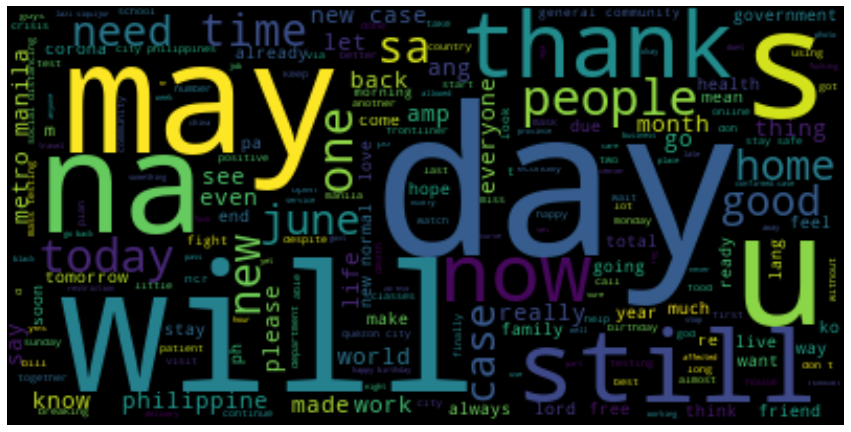

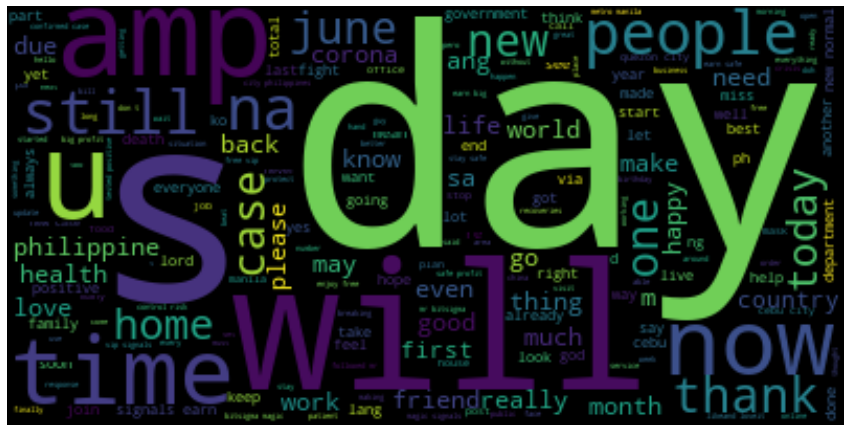

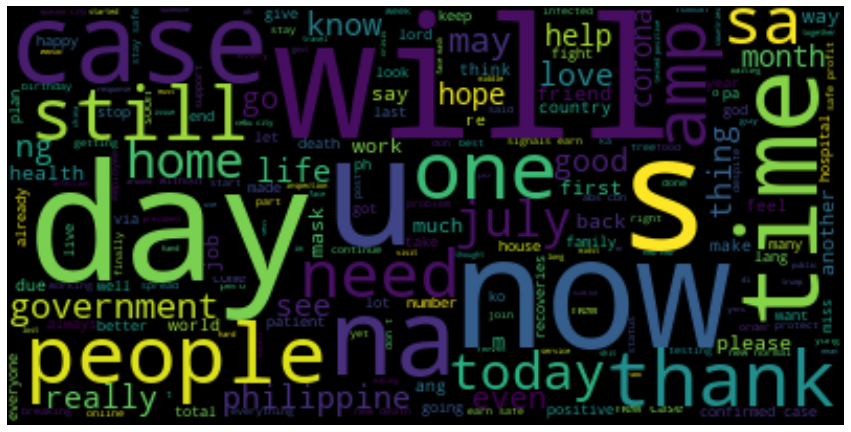

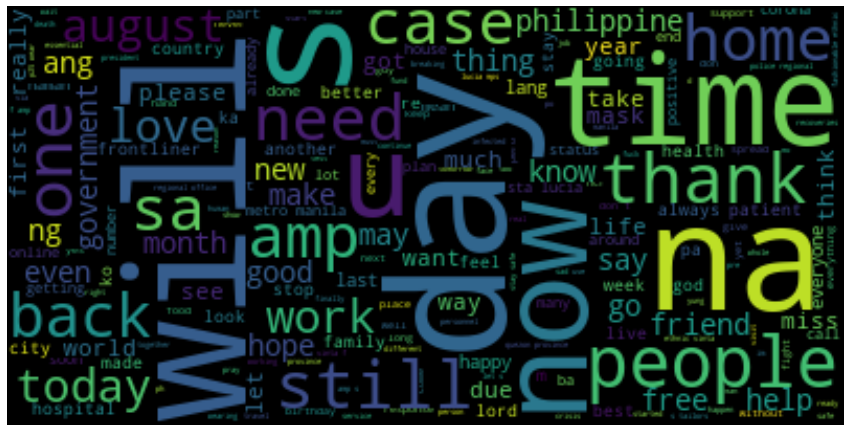

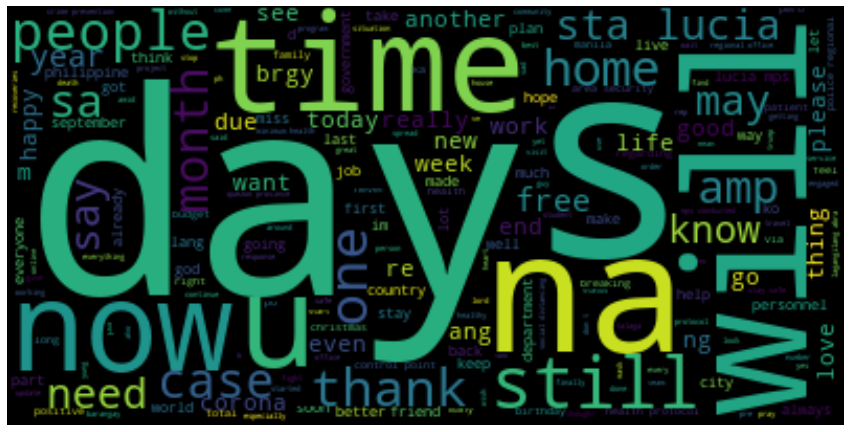

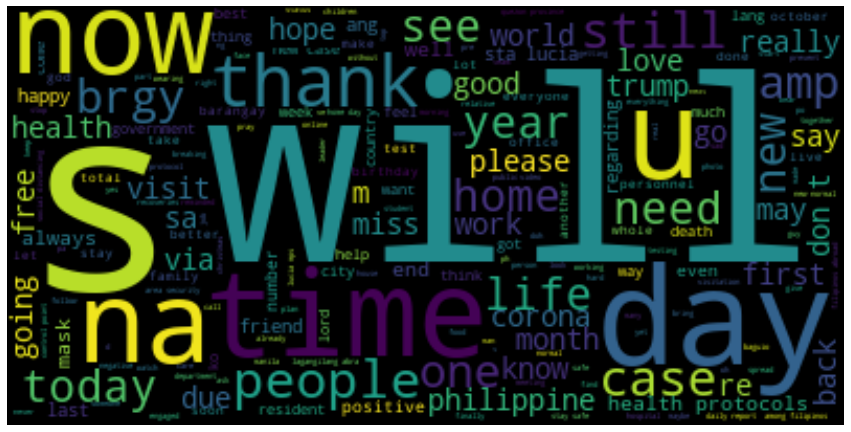

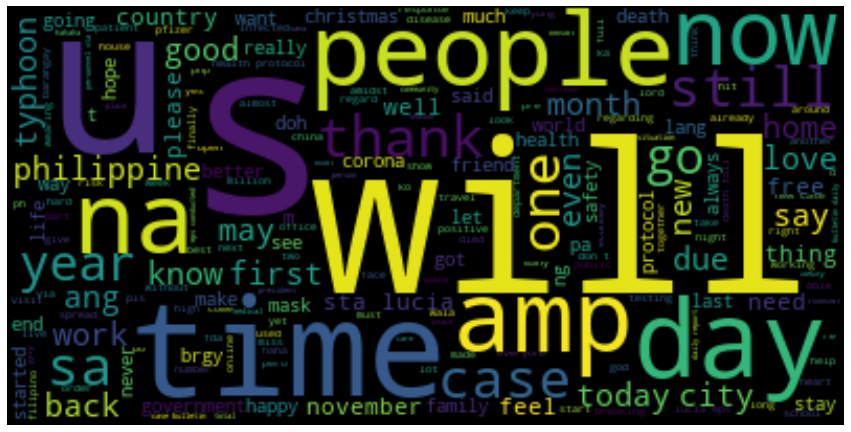

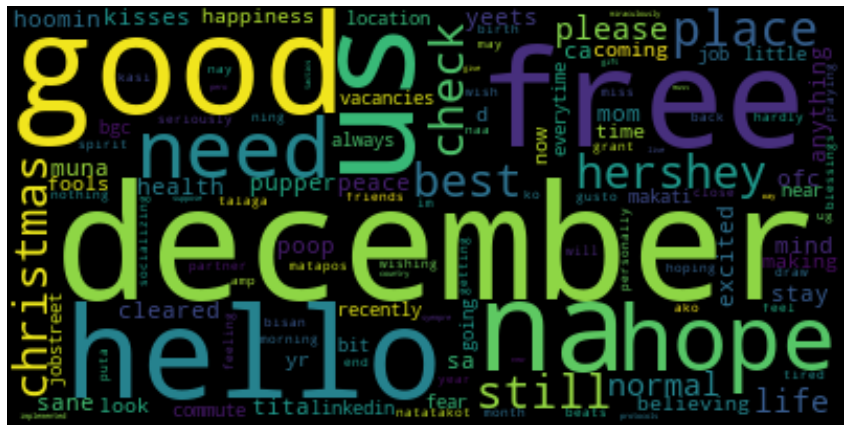

In [124]:
for i in range(len(top_words_per_month)):
    wc = WordCloud().generate(top_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()
    #plt.savefig('WordCloud/vader' + i + '.png')
    wc = wc.to_file('WordCloud/vader_nolist' + str(i) + '.png')

### TextBlob

In [121]:
blob_polarity = []
blob_subjectivity = []

for i in range(len(covid_nolist_df)):
    blob_polarity.append(TextBlob(covid_nolist_df.loc[i]['clean_text']).sentiment.polarity)
    blob_subjectivity.append(TextBlob(covid_nolist_df.loc[i]['clean_text']).sentiment.subjectivity)
    
polarity_array = np.array(blob_polarity)
subjectivity_array = np.array(blob_subjectivity)

covid_nolist_df['blob_polarity'] = polarity_array
covid_nolist_df['blob_subjectivity'] = subjectivity_array
covid_nolist_df.head(2)

,tweet_id,author_id,created_at_utc+8,lang,text,clean_text,month,day,year,hashtags,tokens,vader,blob_polarity,blob_subjectivity
0,1.264847e+18,459997572.0,2020-05-25 17:14:56,en,Snack Time🥤🍝🍔🍟 from McDonald's when we crave ...,snack time from mcdonald's when we crave for ...,5,25,2020,"[#photooftheday, #mcdonalds, #mcdoph, #lovekot...","[snack, time, from, mcdonald, 's, when, we, cr...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.000000,0.000000
1,1.264847e+18,56951008.0,2020-05-25 17:15:10,en,Not in any way close to what I feel right now....,not in any way close to what i feel right now.,5,25,2020,[#quarantinecover],"[not, in, any, way, close, to, what, i, feel, ...","{'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound...",0.285714,0.535714


In [122]:
scores_per_month = []
top_words_per_month = []
pos_words_per_month = []
neu_words_per_month = []
neg_words_per_month = []
pos_num_tweets_per_month = []
neu_num_tweets_per_month = []
neg_num_tweets_per_month = []

for month in months:
    score = 0
    num_tweets = 0
    pos_tweets = 0
    neu_tweets = 0
    neg_tweets = 0
    words = ''
    pos_words = ''
    neu_words = ''
    neg_words = ''
    for i in range(len(covid_nolist_df)):
        if covid_nolist_df.loc[i]['month'] == month:
            score += covid_nolist_df.loc[i]['blob_polarity']
            num_tweets += 1
            words += covid_nolist_df.loc[i]['clean_text']
            if covid_nolist_df.loc[i]['blob_polarity'] > 0:
                pos_words += covid_nolist_df.loc[i]['clean_text']
                pos_tweets += 1
            elif covid_nolist_df.loc[i]['blob_polarity'] == 0:
                neu_words += covid_nolist_df.loc[i]['clean_text']
                neu_tweets += 1
            elif covid_nolist_df.loc[i]['blob_polarity'] < 0:
                neg_words += covid_nolist_df.loc[i]['clean_text']
                neg_tweets += 1
    top_words_per_month.append(words)
    pos_words_per_month.append(pos_words)
    neu_words_per_month.append(neu_words)
    neg_words_per_month.append(neg_words)
    pos_num_tweets_per_month.append(pos_tweets)
    neu_num_tweets_per_month.append(neu_tweets)
    neg_num_tweets_per_month.append(neg_tweets)
    print(f'Month {month}: Compound score: {score} / Num. of tweets: {num_tweets} = Average compound score: {score/num_tweets}')
    scores_per_month.append(score/num_tweets)

Month 5: Compound score: 225.2209728717256 / Num. of tweets: 2094 = Average compound score: 0.10755538341534174
Month 6: Compound score: 672.1962573864358 / Num. of tweets: 6158 = Average compound score: 0.10915821003352319
Month 7: Compound score: 466.7952658410214 / Num. of tweets: 4795 = Average compound score: 0.09735042040480112
Month 8: Compound score: 381.7770764654452 / Num. of tweets: 4190 = Average compound score: 0.0911162473664547
Month 9: Compound score: 247.63575285582365 / Num. of tweets: 2705 = Average compound score: 0.09154741325538768
Month 10: Compound score: 201.62019669127173 / Num. of tweets: 2317 = Average compound score: 0.08701778018613368
Month 11: Compound score: 209.6458018081178 / Num. of tweets: 1793 = Average compound score: 0.11692459665818059
Month 12: Compound score: 3.166843434343434 / Num. of tweets: 11 = Average compound score: 0.28789485766758494


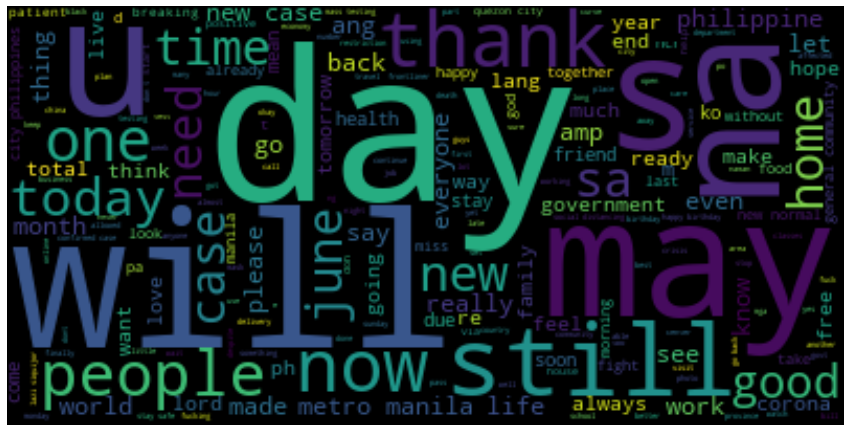

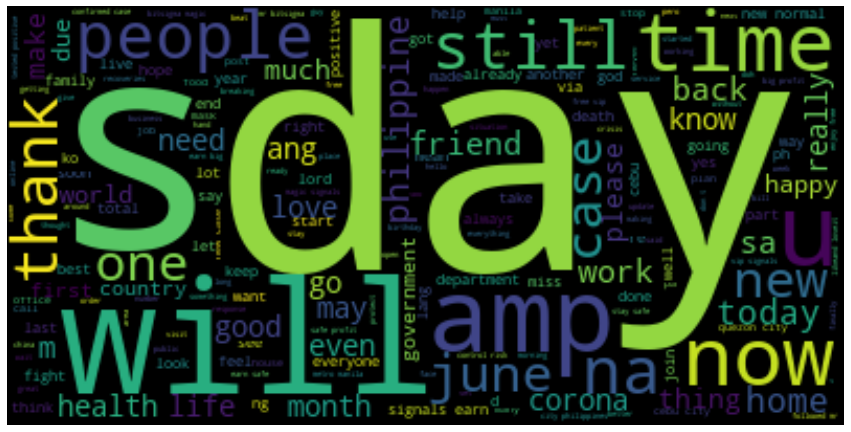

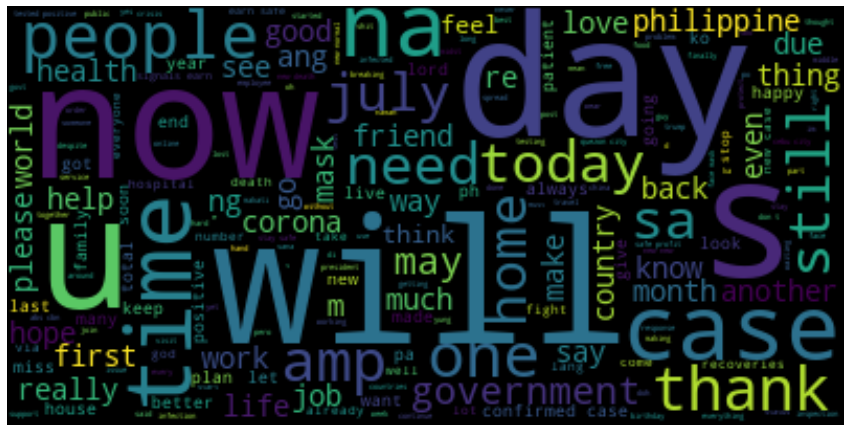

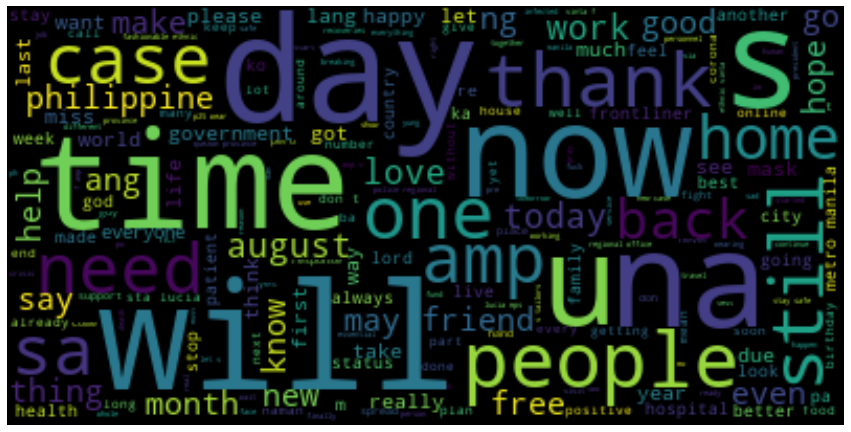

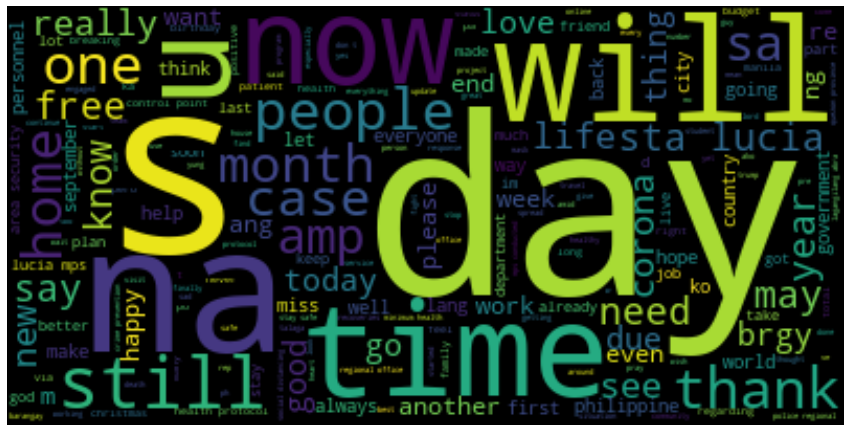

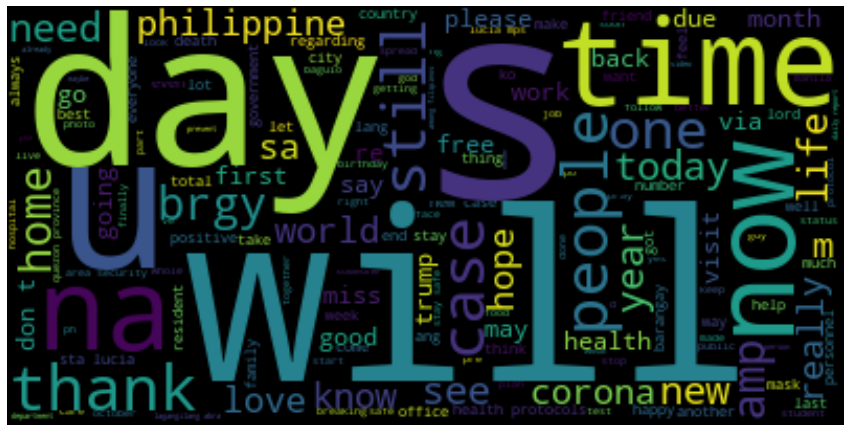

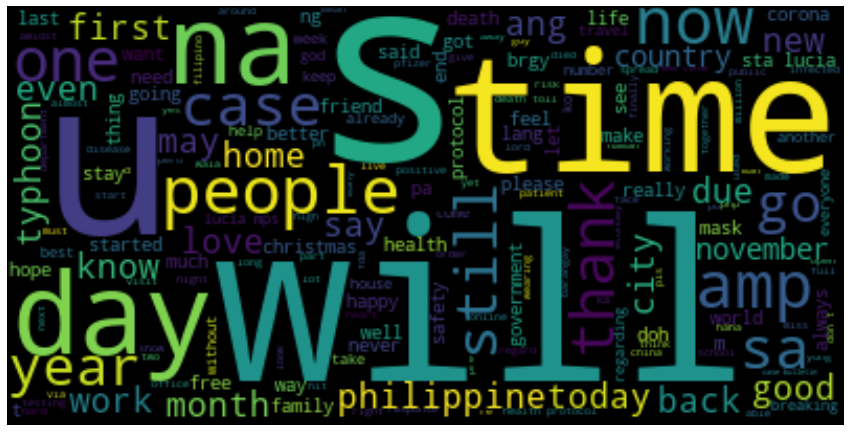

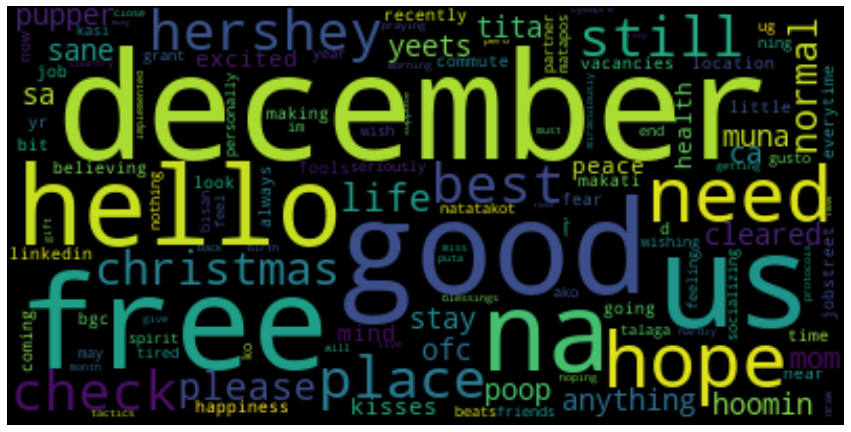

In [125]:
for i in range(len(top_words_per_month)):
    wc = WordCloud().generate(top_words_per_month[i])
    plt.figure(figsize=(15,8))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()
    #plt.savefig('WordCloud/vader' + i + '.png')
    wc = wc.to_file('WordCloud/textblob_nolist' + str(i) + '.png')